# 05.03v04 Scanpy Clustering All
This Jupyter notebook (05.05) details the clustering steps using optimized neighbor and PCs.

**This notebook also outputs a CSV file of the obs dataframe which contains sample-leiden cluster assignments.**

This is the third version (v02) of this notebook. Future changes will be annotated below this line.

 - v00 - This code outlines clustering steps with UMAP and force-directed graphs. Neighbor = 15, PCs = 40
 - v01 - Analysis of new Runx3-mut data, visualization of phase data
 - v02 - Analysis of ambient RNA-corrected and scDblFinder filtered data
 - v03 - Re-analysis on 16 Oct 23
 - v04 - All analysis

## Initialize Environment
First import all the necessary packages here:

In [1]:
# Import necessary packages
import os
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ad
import seaborn as sns
import scanpy.external as sce
import matplotlib.pyplot as pl
import anndata2ri
import logging

from matplotlib import colors
from datetime import datetime as dt
from scipy.stats import median_abs_deviation

pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False, dpi_save=300, transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.set_figure_params(color_map='viridis')
colorsComb = np.vstack([pl.cm.Reds(np.linspace(0, 1, 10)), pl.cm.Greys_r(np.linspace(0.7, 0.8, 0))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.settings.verbosity = 0 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=120, color_map='viridis')  # low dpi (dots per inch) yields small inline figures

Identify the starting directory. Get a timestamp for the run. From the timestamp, derive the resulting output h5ad filename.

In [2]:
# Name Variables and Settings
prefix = "05.03v04_Data_"                                # Filename Prefix
savedata = True                                          # Save data at the end

# Determine work location
print("The work location for this notebook is: " + os.getcwd() + "\n")

# Get a timestamp for the start of the run
timestamp = dt.now()
print("This notebook was last run on " + timestamp.strftime("%y-%m-%d %H:%M") + " UTC\n")

# Determine the filename for the expected output h5ad
fn = prefix + timestamp.strftime("%y-%m-%d-%H-%M") + "_clustering_Rescue.h5ad"
print("The filename for the AnnData output of this notebook will be:")
print(fn)
print("which will be saved in the WORKDIR/h5ad/ folder.\n")

The work location for this notebook is: /home/dsalbao/work/2023-020-Diao-Reanalysis/D8_03_scanpy

This notebook was last run on 23-12-04 18:17 UTC

The filename for the AnnData output of this notebook will be:
05.03v04_Data_23-12-04-18-17_clustering_Rescue.h5ad
which will be saved in the WORKDIR/h5ad/ folder.



The work directory is structured to contain a folder named "h5ad" which itself contains output from previous analysis steps. Import data from the latest analysis:

In [3]:
# Determine input file
input = "05.01v04_Data_23-10-30-00-17_singlet_preprocessing.h5ad"
print("The input h5ad file is: h5ad/" + input)

# List items in outs folder
adata = ad.read_h5ad("h5ad/" + input)

# Inspect AnnData
print(adata)

The input h5ad file is: h5ad/05.01v04_Data_23-10-30-00-17_singlet_preprocessing.h5ad
AnnData object with n_obs × n_vars = 13101 × 16338
    obs: 'experiment', 'group', 'timepoint', 'infection', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'scDblFinder_score', 'scDblFinder_class', 'QC', 'n_genes', 'S_score', 'G2M_score', 'phase'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'n_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'group_colors', 'hvg', 'log1p', 'pca', 'scrublet'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'soupX_counts'


## Nearest Neighbor Analyses and UMAP

Visual optimization suggests using 40 PCs with a 15 nearest neighbors. This is based on visual inspection of notebook 05.02v00.

2023-12-04 18:17:57.030837: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


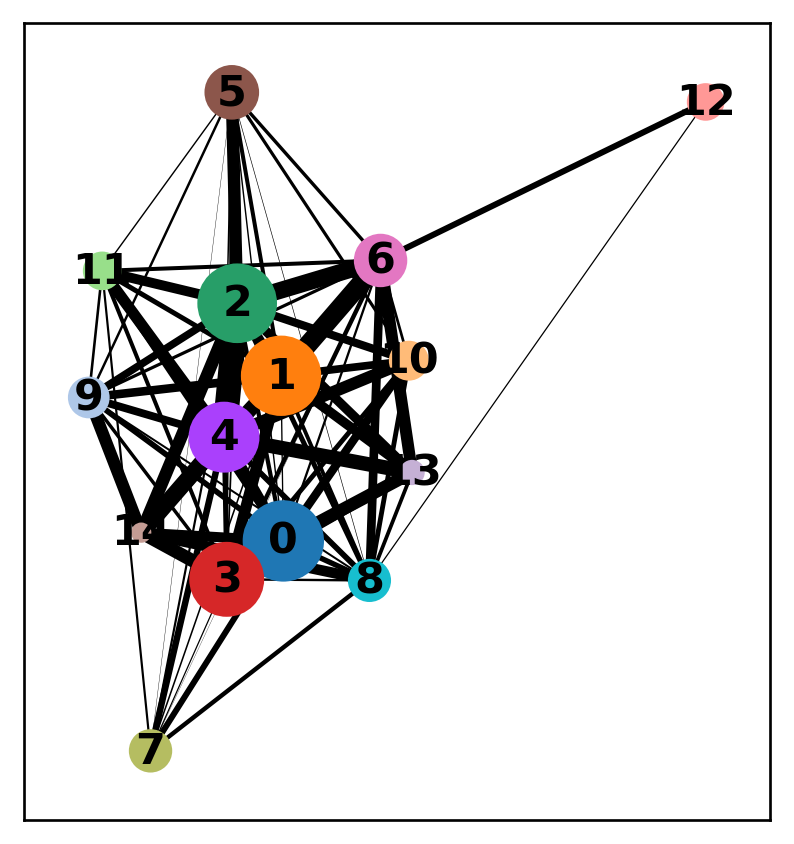

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future ve

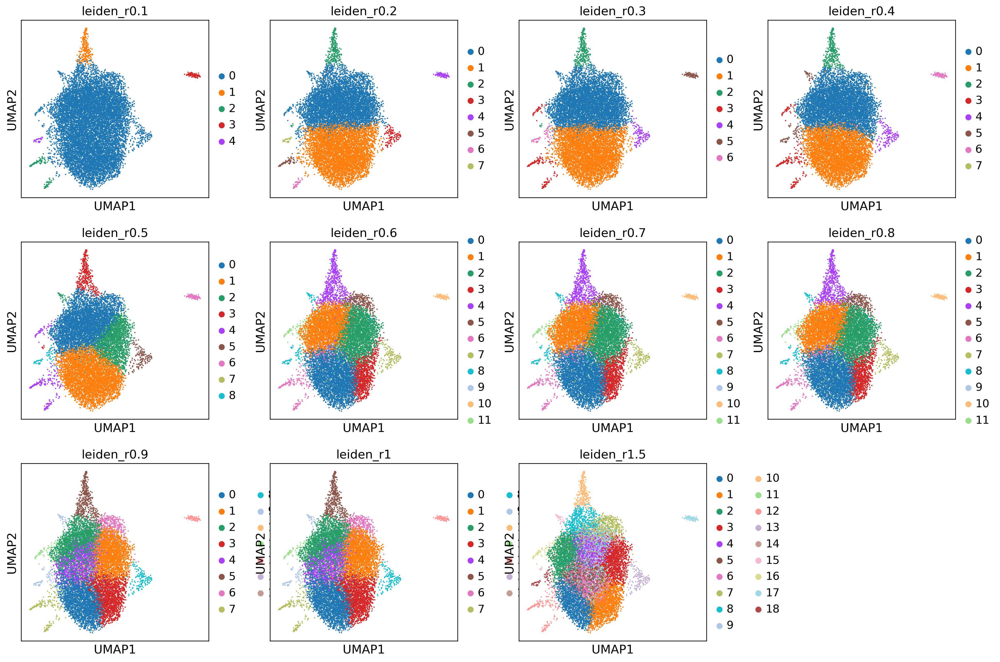

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


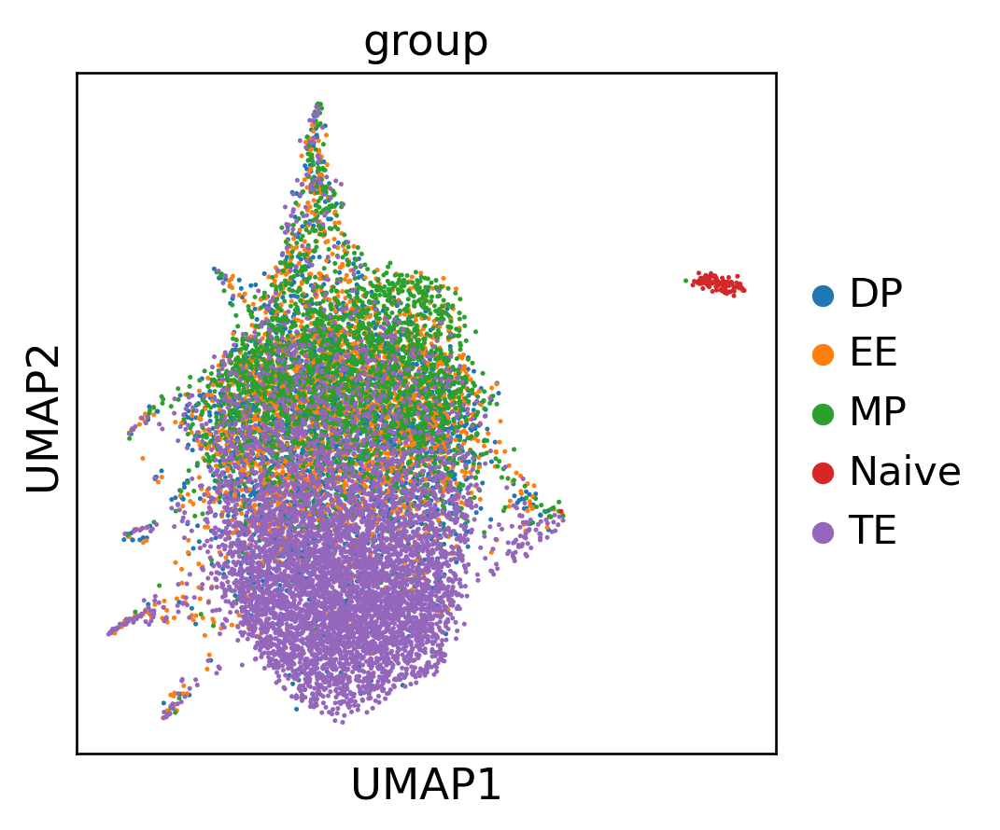

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


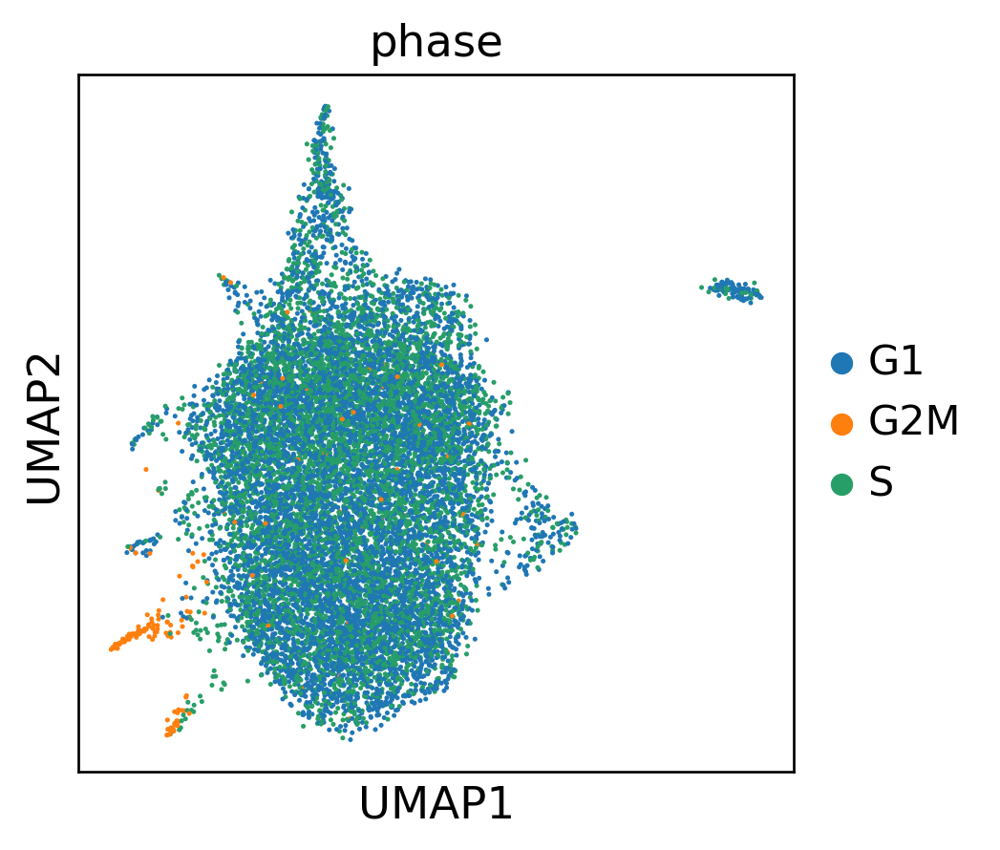

In [4]:
# Calculate nearest neighbors with n_neighbors 15 and 40 pcs
sc.pp.neighbors(adata, n_neighbors = 15, n_pcs = 40)

# Perform leiden clustering
sc.tl.leiden(adata,random_state=1,resolution=1.5, key_added='leiden_r1.5')
sc.tl.leiden(adata,random_state=1,resolution=1, key_added='leiden_r1')
sc.tl.leiden(adata,random_state=1,resolution=1, key_added='leiden_r0.9')
sc.tl.leiden(adata,random_state=1, resolution=0.8, key_added='leiden_r0.8')
sc.tl.leiden(adata,random_state=1, resolution=0.8, key_added='leiden_r0.7')
sc.tl.leiden(adata,random_state=1, resolution=0.8, key_added='leiden_r0.6')
sc.tl.leiden(adata,random_state=1, resolution=0.5, key_added='leiden_r0.5')
sc.tl.leiden(adata,random_state=1, resolution=0.4, key_added='leiden_r0.4')
sc.tl.leiden(adata,random_state=1, resolution=0.3, key_added='leiden_r0.3')
sc.tl.leiden(adata,random_state=1, resolution=0.2, key_added='leiden_r0.2')
sc.tl.leiden(adata,random_state=1, resolution=0.1, key_added='leiden_r0.1')

# Initialize PAGA
sc.tl.paga(adata, groups = 'leiden_r1')

# Plot PAGA
sc.pl.paga(adata)

# Calculate UMAP using intialized PAGA
sc.tl.umap(adata, init_pos='paga')

# Plot UMAP with annotation by leiden clusters and original identity
sc.pl.umap(adata, color = ['leiden_r0.1',  'leiden_r0.2', 'leiden_r0.3', 'leiden_r0.4', 'leiden_r0.5',  'leiden_r0.6', 'leiden_r0.7', 'leiden_r0.8',
                          'leiden_r0.9', 'leiden_r1', 'leiden_r1.5'])
sc.pl.umap(adata, color = "group")
sc.pl.umap(adata, color = "phase")

Visualize expression levels throughout the UMAP of key genes:

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


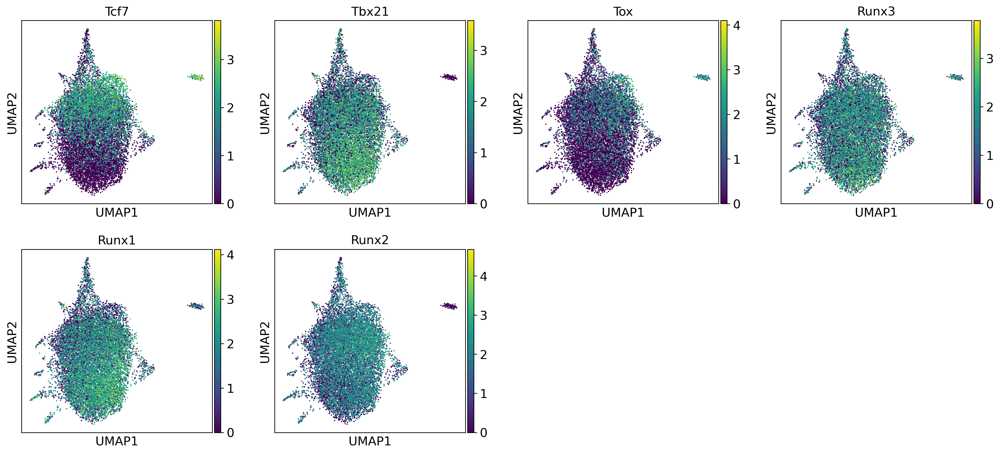

In [5]:
sc.pl.umap(adata, color = ["Tcf7", "Tbx21", "Tox", "Runx3", "Runx1", "Runx2"])

## Force Atlas Projections

Perform a force-atlas projection based on the initialized PAGA.

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


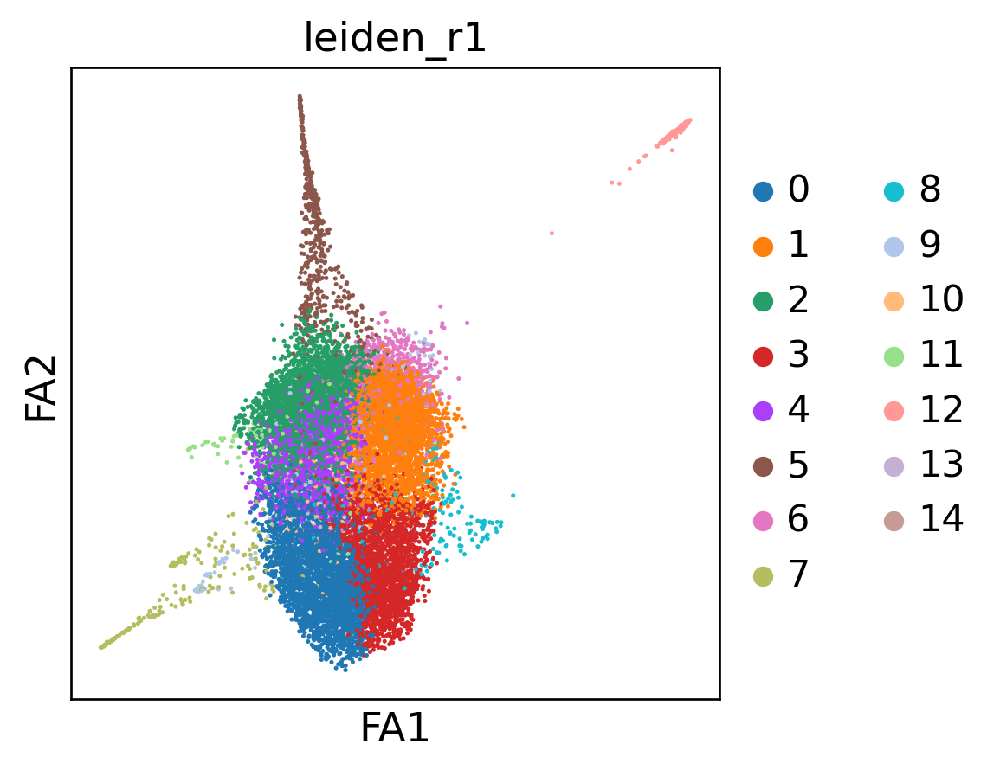

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


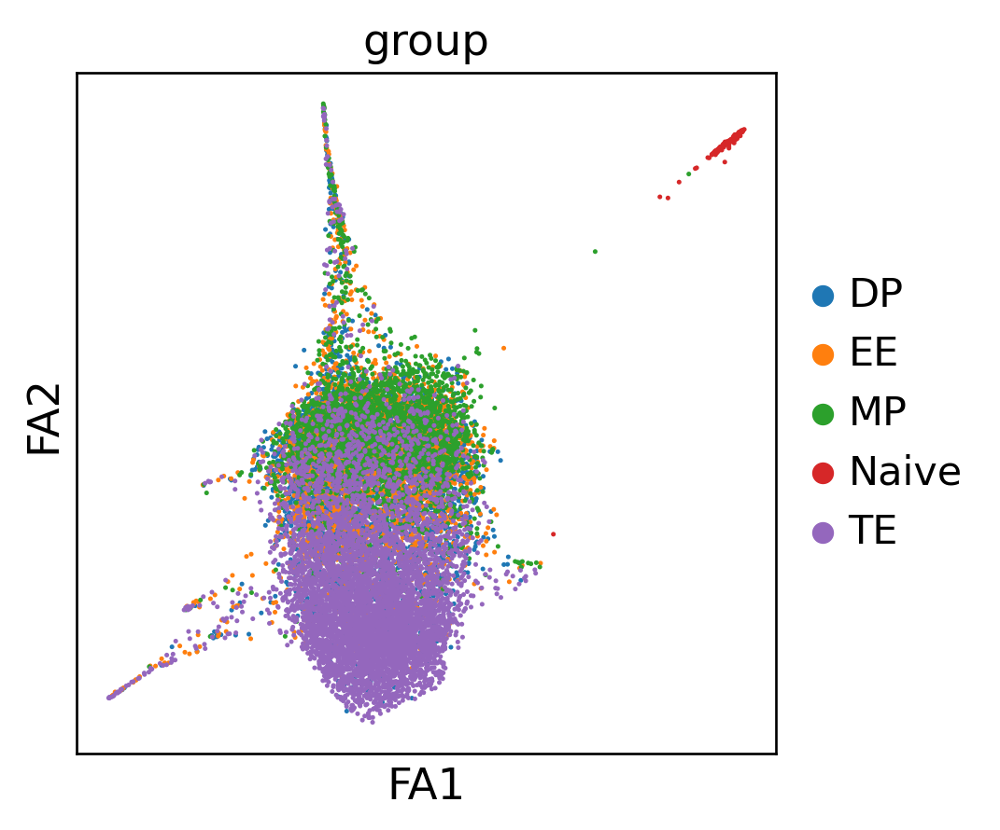

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


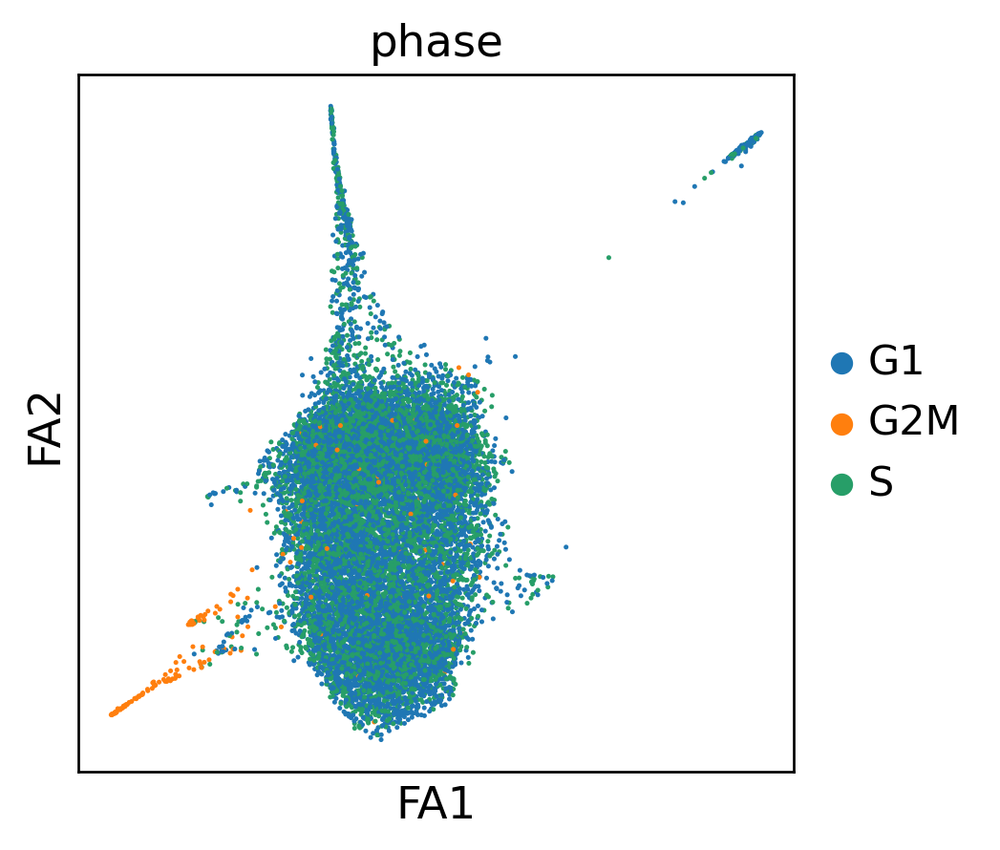

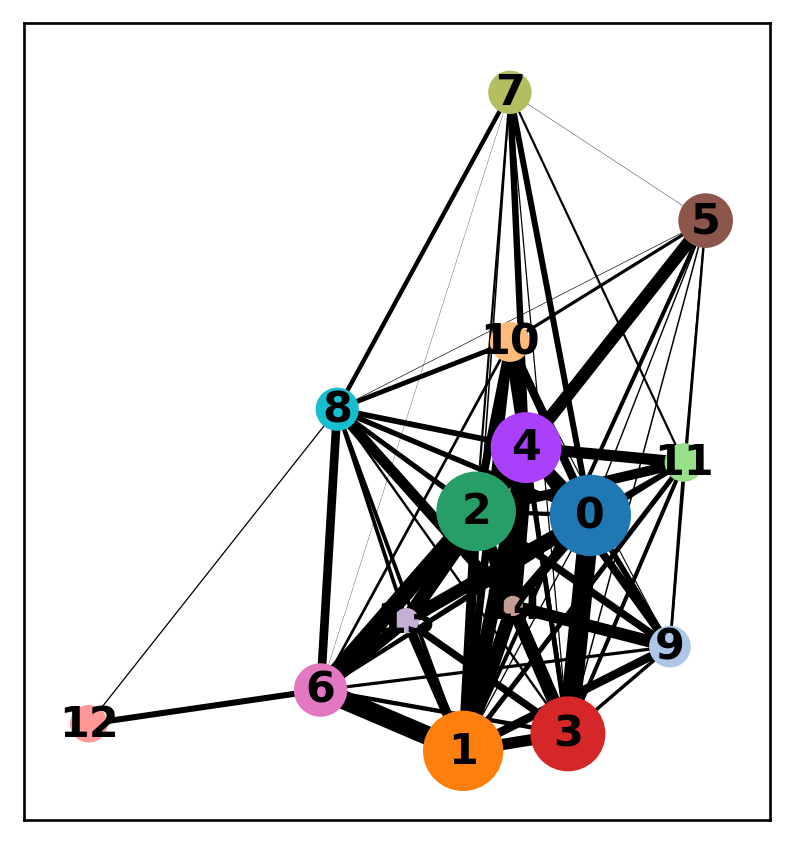

In [6]:
# Calculate the force atlas based on the initialized PAGA
sc.tl.draw_graph(adata, layout = "fa", init_pos = "paga", n_jobs = 20)

# Plot the resulting force atlas annotated by leiden clusters and original identity
sc.pl.draw_graph(adata, layout = "fa", color = ['leiden_r1'])
sc.pl.draw_graph(adata, layout = "fa", color = "group")
sc.pl.draw_graph(adata, layout = "fa", color = "phase")

# Plot the new PAGA positions based on the force atlas
sc.pl.paga(adata, layout = "fa")

## Cluster-Group Distributions
Analyze the distribution of each sample into different leiden clusters.

In [7]:
# Get leiden clusters and original identities
obs_df = sc.get.obs_df(adata, ["group", "leiden_r1"])
# Print top 5 observations
print(obs_df.head())
# Print tapply
print(obs_df.groupby("group").value_counts().unstack())

                   group leiden_r1
AAACCCAAGATGACAT-1    DP         2
AAACCCAAGGTTGCCC-1    DP         1
AAACCCACATTCTCTA-1    DP         1
AAACCCAGTTCGGTAT-1    DP         6
AAACCCATCATTCTTG-1    DP         1
leiden_r1     0    1    2     3    4    5    6   7   8   9  10  11  12  13  14
group                                                                         
DP          248  779  684   214  482  117   53  17  36  50  42  27   0   2   0
EE           95  630  591   112  359  138  107  67  40  31  28  25   0   6   2
MP           23  733  825    34  309  158  270   9  27  30  14  26   2   2   1
Naive         0    0    0     0    0    0    0   0   1   0   0   0  99   0   0
TE         2347  436  387  1566  379   94   31  95  80  48  47  36   0   7   3


/tmp/ipykernel_54030/732274759.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(obs_df.groupby("group").value_counts().unstack())


## Save Data
Procedures for saving data are outlined below:

In [8]:
# Reminder for the saved data
if savedata:
    print("The filename for the AnnData output of this notebook will be: ")
    print(fn)
    print("which will be saved in the h5ad/ folder.")
    
    # Save data to an AnnData file
    adata.write_h5ad(filename = "h5ad/" + fn, compression = "gzip", compression_opts = 9)
    print(adata)
    
    # Get all observations into obs_df
    obs_df = adata.obs
    
    # Determine the filename for the expected output csv
    fn_csv = prefix + timestamp.strftime("%y-%m-%d-%H-%M") + "_obsDF_Rescue.csv"
    print("\nThe filename for the CSV output of this notebook will be:")
    print(fn_csv)
    print("which will be saved in the WORKDIR/csv/ folder.\n")
    
    # Export CSV
    obs_df.to_csv("csv/" + fn_csv, index = False)

else:

    print("Not saving the AnnData file!")
    
# End of Notebook
print("\nNotebook Ends")

The filename for the AnnData output of this notebook will be: 
05.03v04_Data_23-12-04-18-17_clustering_Rescue.h5ad
which will be saved in the h5ad/ folder.
AnnData object with n_obs × n_vars = 13101 × 16338
    obs: 'experiment', 'group', 'timepoint', 'infection', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'scDblFinder_score', 'scDblFinder_class', 'QC', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.9', 'leiden_r0.8', 'leiden_r0.7', 'leiden_r0.6', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leiden_r0.1'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'n_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for th

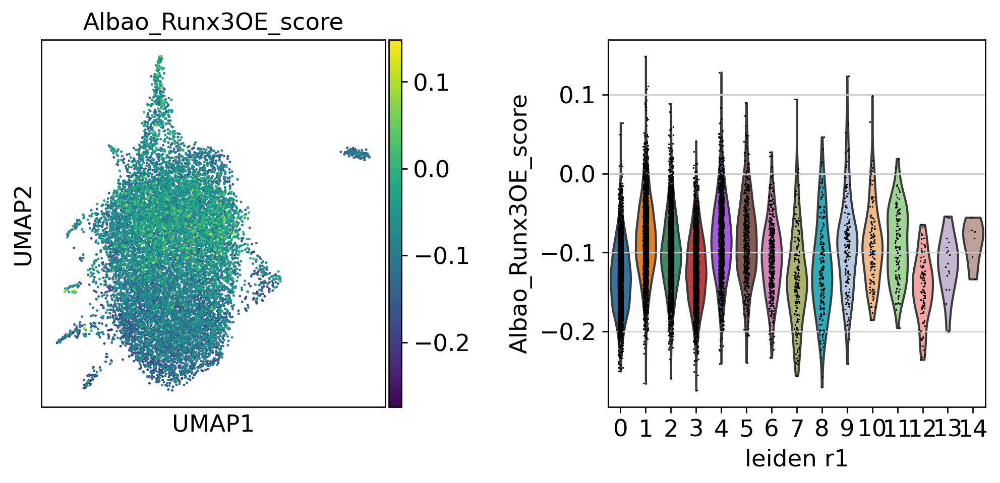

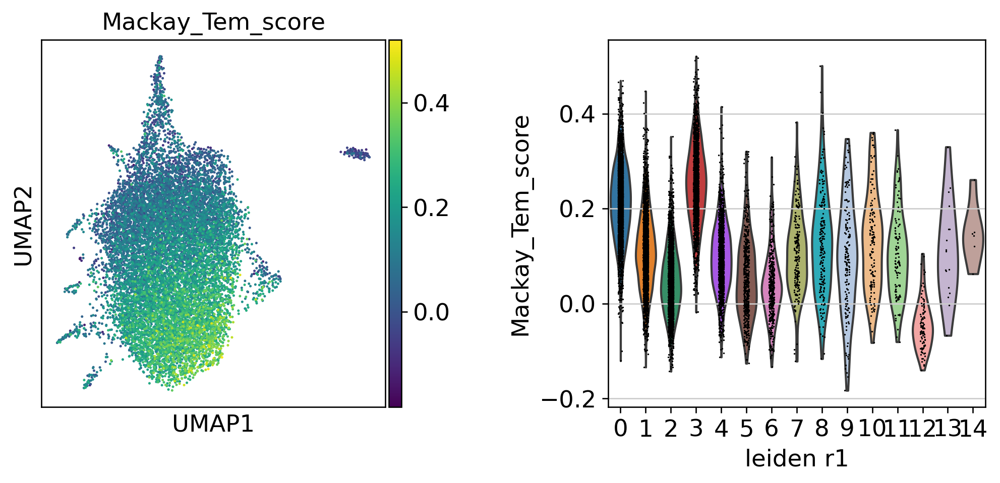

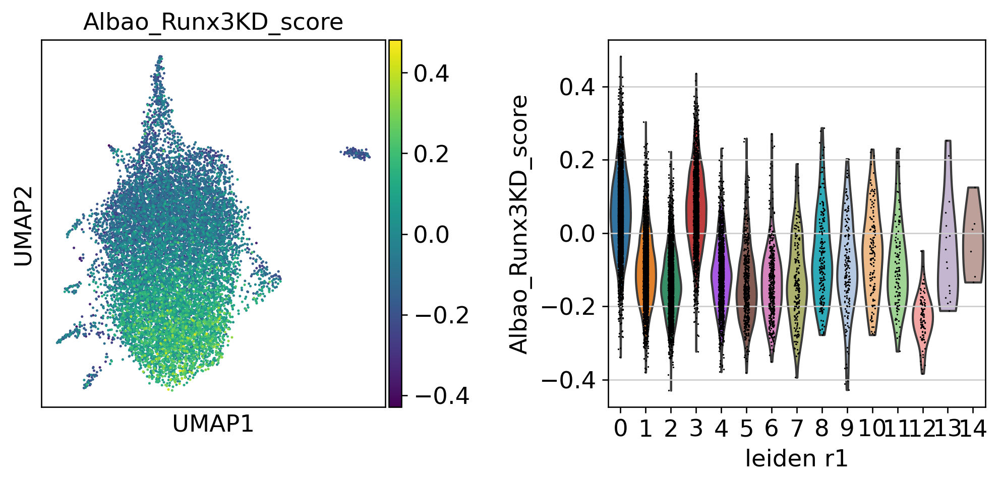

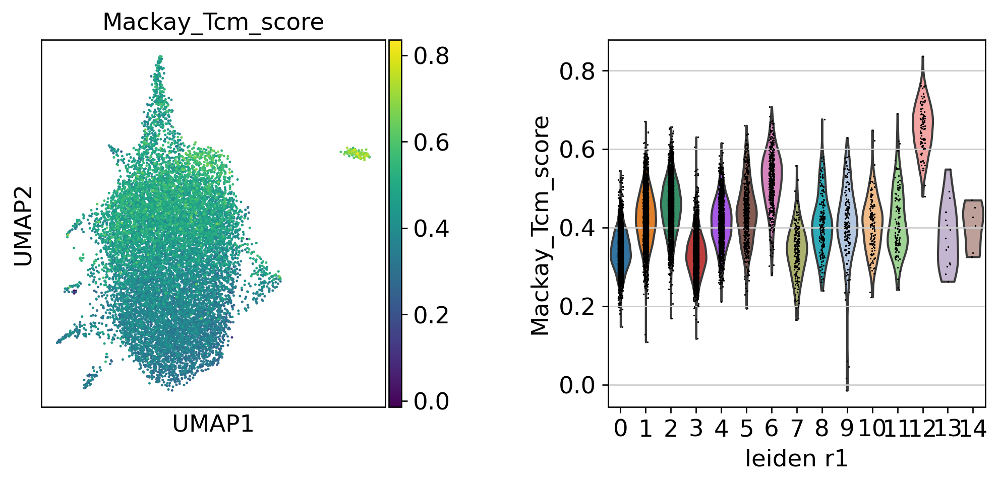

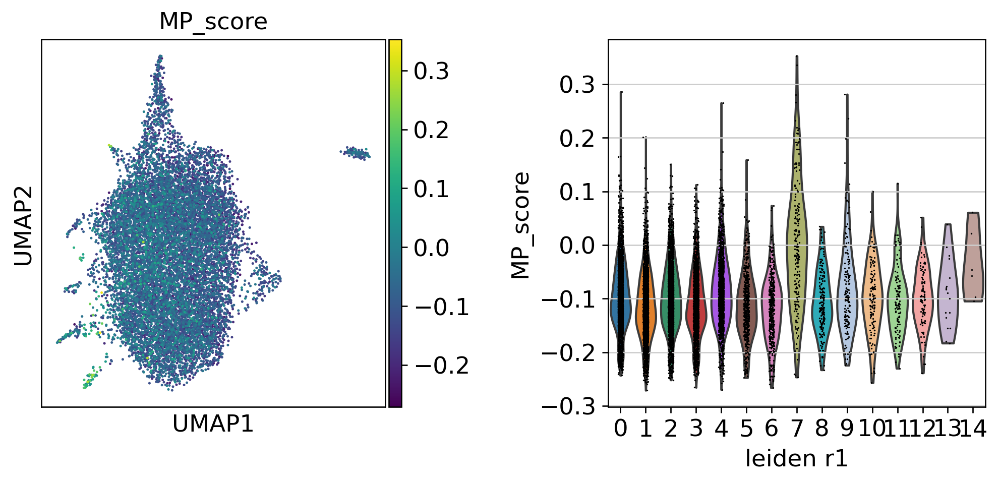

...

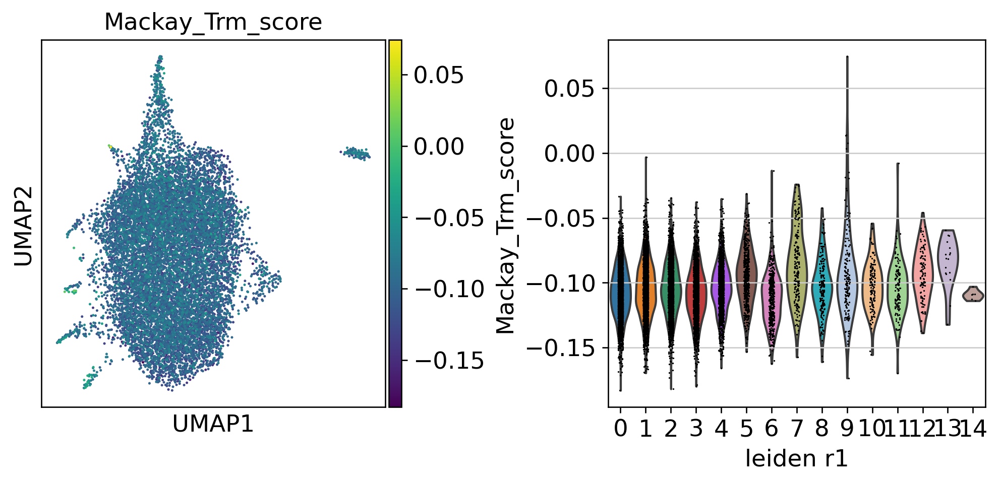

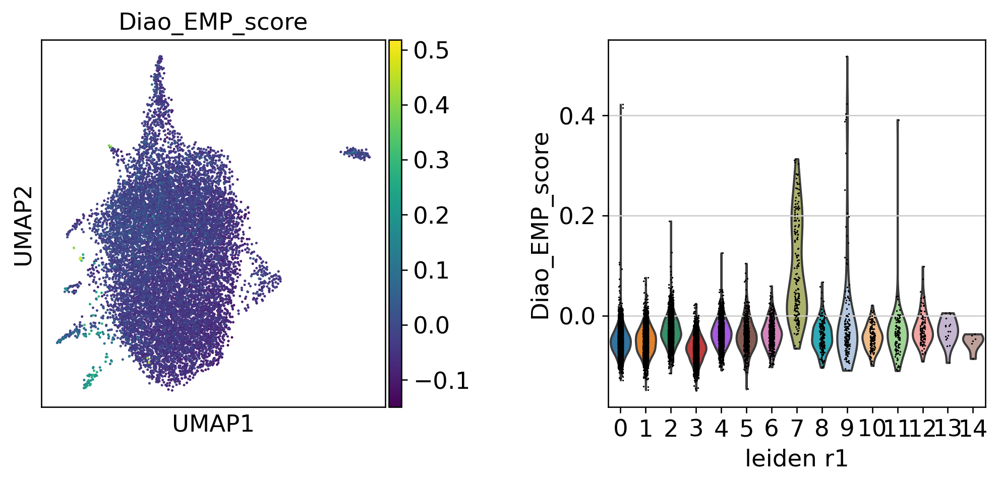

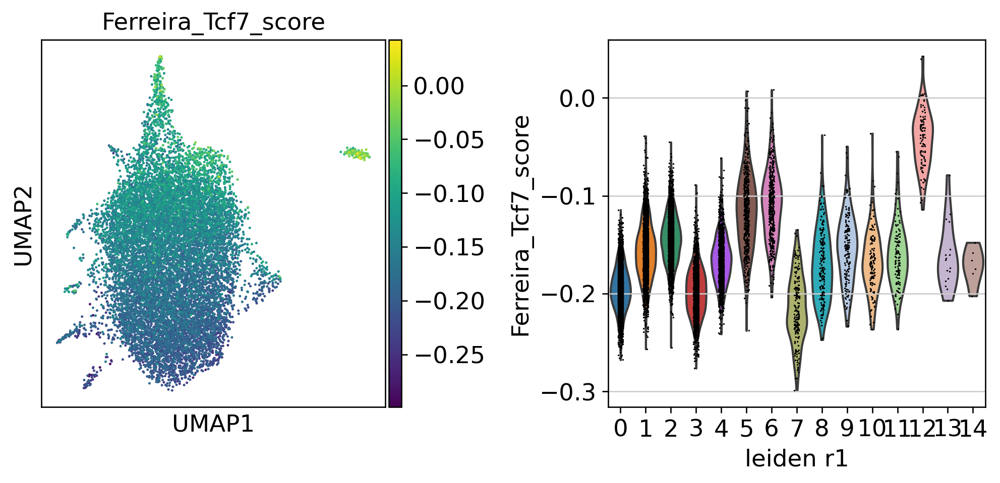

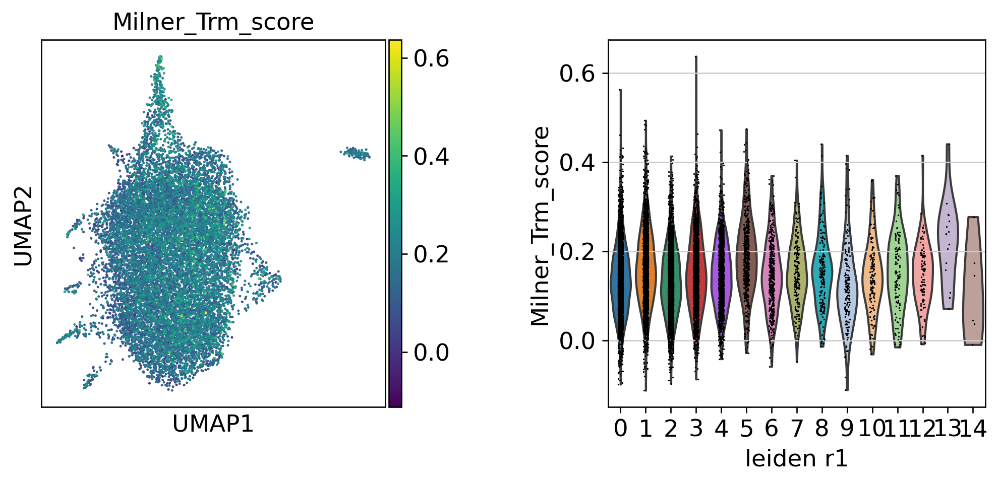

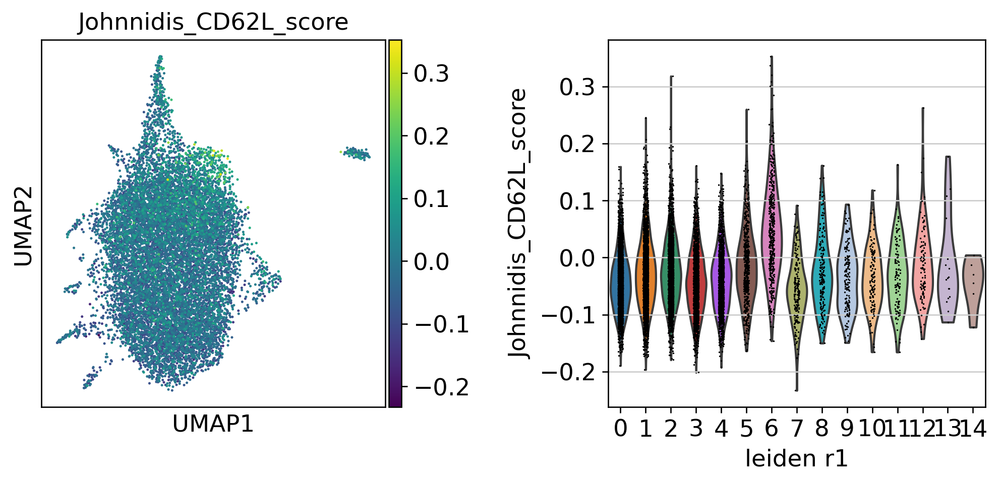

In [9]:
list_names = os.listdir("ref/Signatures")

list_names = [filename.replace('.txt', '') for filename in list_names]
list_names

gene_lists = dict()

for gene_set in list_names:
    gene_lists[gene_set] = list(pd.read_csv("ref/Signatures/" + gene_set + ".txt", sep="\t", index_col=0).index)

# Score gene lists
import matplotlib.pyplot as plt

for gene_set in list_names:
    sc.tl.score_genes(adata=adata, gene_list=gene_lists[gene_set], score_name=gene_set+"_score")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.5})
    ax1_dict = sc.pl.umap(adata, color=gene_set+"_score", ax=ax1, show=False)
    ax2_dict = sc.pl.violin(adata, gene_set+"_score", groupby="leiden_r1", ax=ax2, show=False)

import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import spearmanr


df_orig = sc.get.obs_df(adata, ["Runx3", "Runx1", "Runx2", "Tcf7", "Tox", "leiden_r1", "group"] + [item + "_score" for item in list_names])

def scatter_continuous(df, x, y, hue):
    df = df.sort_values(by=hue, ascending=True)

    # Compute the Spearman correlation and p-value
    correlation, p_value = spearmanr(df[x], df[y])
    
    # Create the main figure and axis
    fig, ax = plt.subplots()
    
    # Adjust the plot layout to make room for the annotation at the top
    fig.subplots_adjust(top=0.85)  # you might need to tweak this value
    
    # Plot the regression trendline for the entire dataset
    sns.regplot(x=x, y=y, data=df, scatter=False, color='black', ax=ax)
    
    # Overlay the scatter plot, coloring by the continuous variable
    scatter = sns.scatterplot(x=x, y=y, hue=hue, data=df, palette="viridis", edgecolor=None, ax=ax)
    
    # Remove the original legend
    ax.legend_.remove()
    
    # Create a new colorbar
    norm = plt.Normalize(df[hue].min(), df[hue].max())
    sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
    sm.set_array([])
    
    # Add the colorbar to the right of the plot
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical')
    cbar.set_label(hue)
    
    # Add the Spearman R and p-value ABOVE the plot
    ax.annotate(f"Spearman R = {correlation:.2f}\np-value = {p_value:.2g}", 
                xy=(0.25, 1), xycoords='figure fraction', ha='left', va='top')
    
    # Display the plot
    plt.show()

def scatter_discrete(df, x, y, hue):
    # Compute the Spearman correlation and p-value
    correlation, p_value = spearmanr(df[x], df[y])
    
    # Create the main figure and axis
    fig, ax = plt.subplots()
    
    # Adjust the plot layout to make room for the annotation at the top
    fig.subplots_adjust(top=0.85)  # you might need to tweak this value
    
    # Plot the regression trendline for the entire dataset
    sns.regplot(x=x, y=y, data=df, scatter=False, color='black', ax=ax)
    
    # Overlay the scatter plot, coloring by the hue
    sns.scatterplot(x=x, y=y, hue=hue, data=df, ax=ax)
    
    # Explicitly remove the legend
    ax.legend_.remove()
    
    # Add the Spearman R and p-value ABOVE the plot
    ax.annotate(f"Spearman R = {correlation:.2f}\np-value = {p_value:.2g}", 
                xy=(0.25, 1), xycoords='figure fraction', ha='left', va='top')
    
    # Show the plot
    plt.show()

def scatter_select(df, x, y, hue, highlight):
    # Compute the Spearman correlation and p-value
    correlation, p_value = spearmanr(df[x], df[y])
    
    # Create the main figure and axis
    fig, ax = plt.subplots()

    # Adjust the plot layout to make room for the annotation at the top
    fig.subplots_adjust(top=0.85)  # you might need to tweak this value
    
    # Plot the regression trendline for the entire dataset
    sns.regplot(x=x, y=y, data=df, scatter=False, color='black', ax=ax)
    
    # Custom color mapping for leiden_r1 values
    color_mapping = {highlight: 'darkred'}
    colors = df[hue].map(lambda x: color_mapping.get(x, 'grey'))
    
    # Sort the DataFrame such that entries with "6" in leiden_r1 come last
    df_sorted = df.sort_values(by=hue, key=lambda col: col == highlight, ascending=True)
    
    # Overlay the scatter plot with custom colors
    sns.scatterplot(x=x, y=y, color=colors.loc[df_sorted.index], data=df_sorted, edgecolor=None, ax=ax, legend=False)
    
    # Add the Spearman R and p-value ABOVE the plot
    ax.annotate(f"Spearman R = {correlation:.2f}\np-value = {p_value:.2g}", 
                xy=(0.25, 1), xycoords='figure fraction', ha='left', va='top')
    
    # Display the plot
    plt.show()

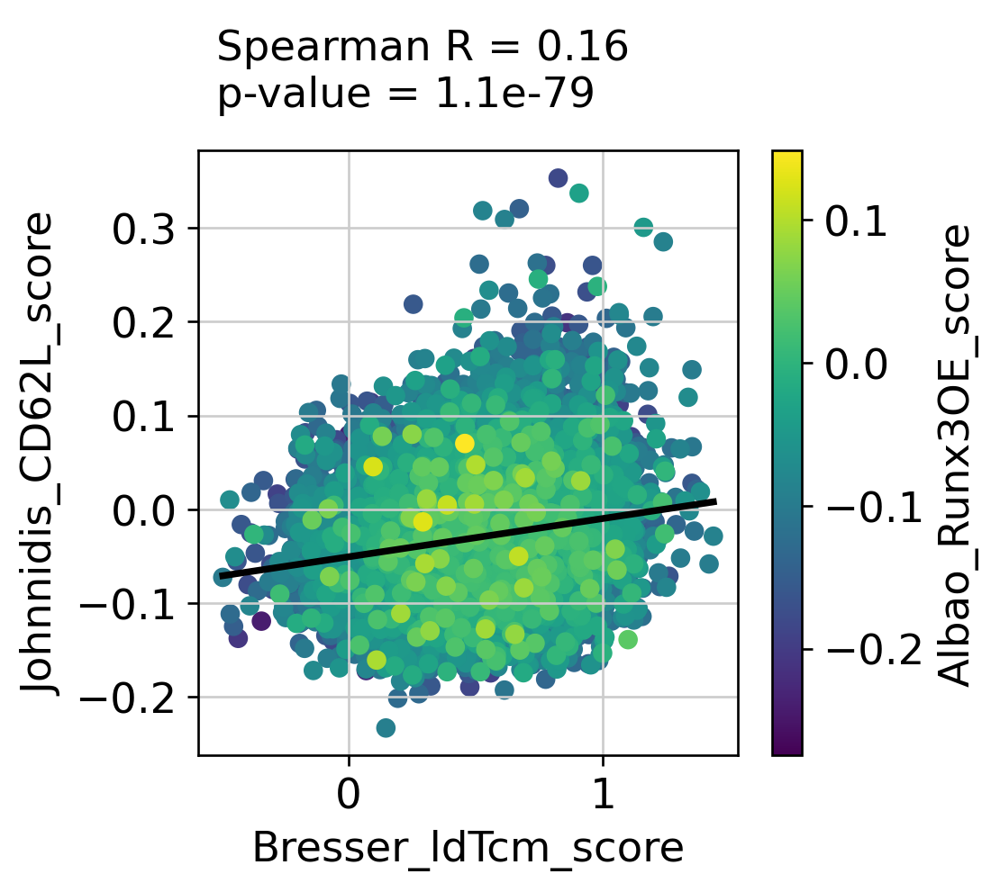

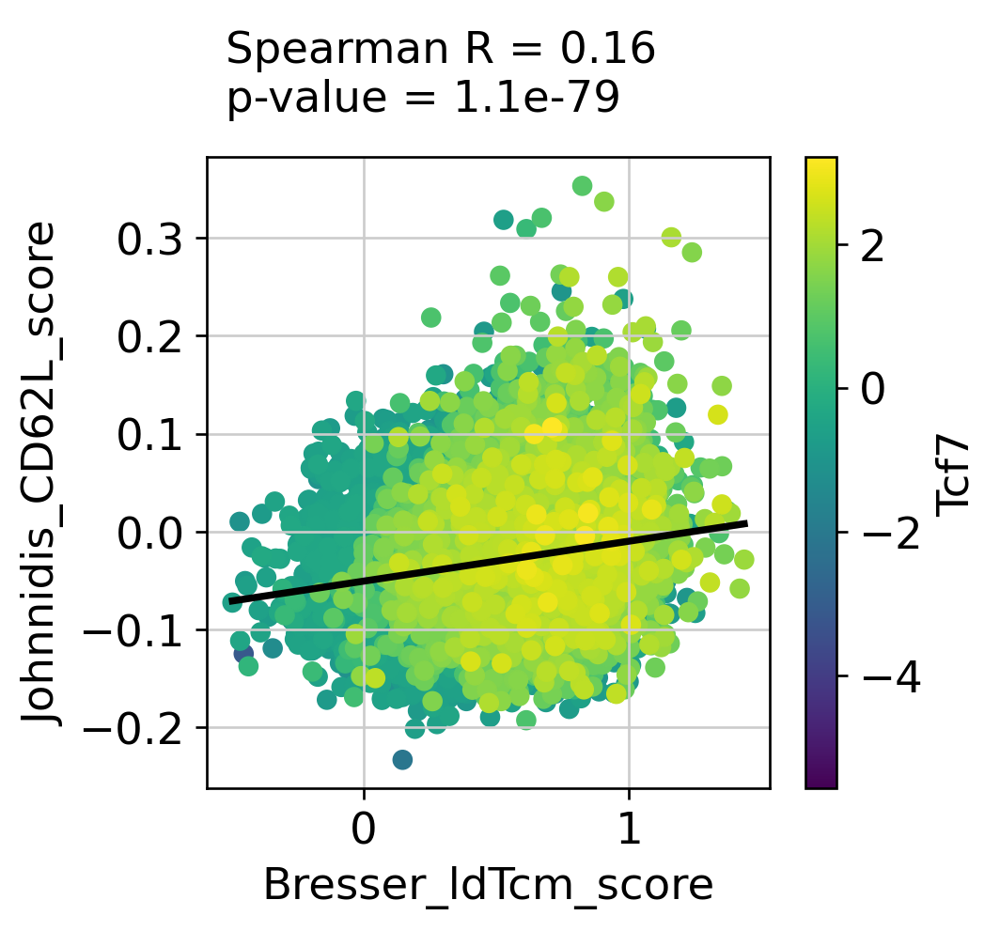

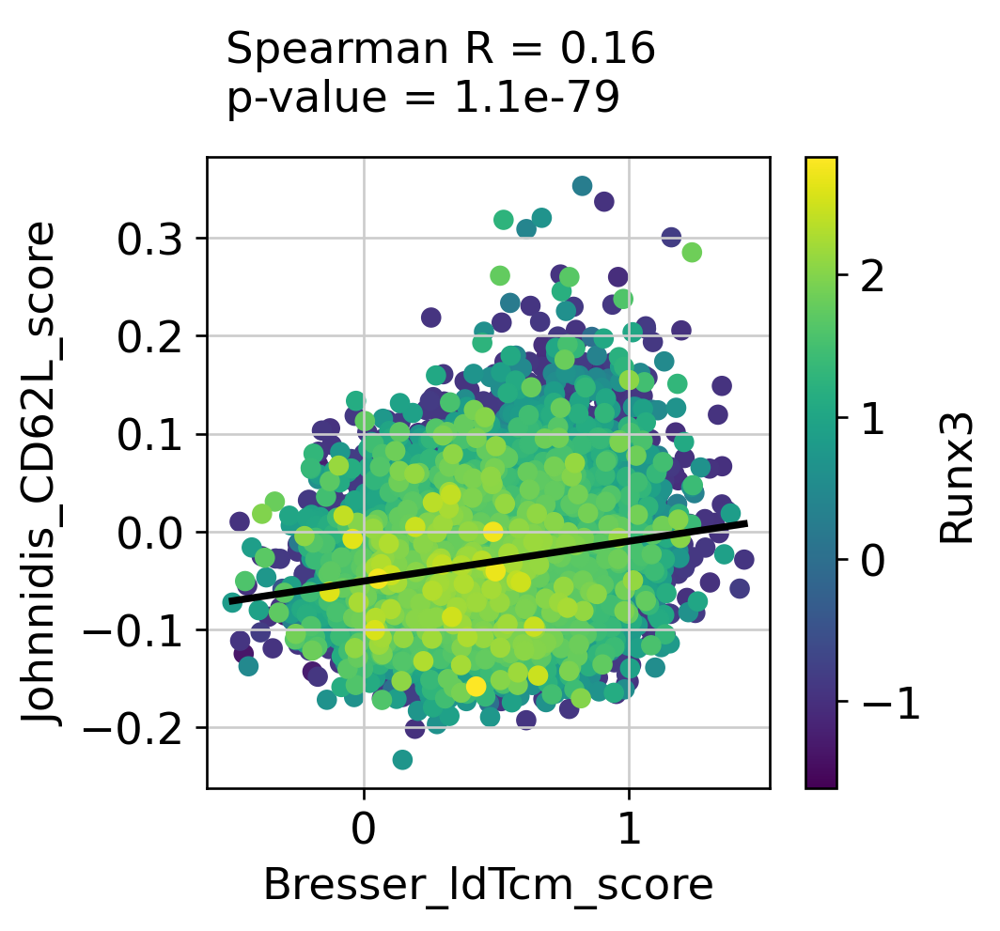

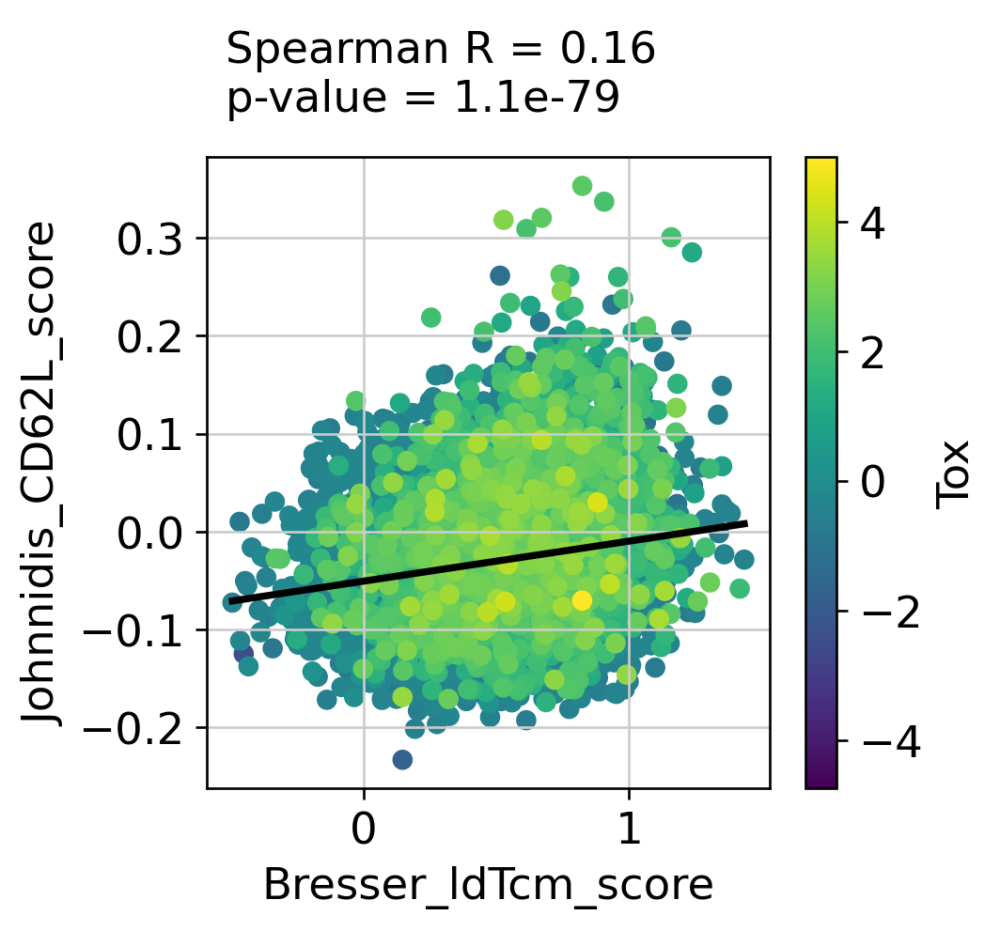

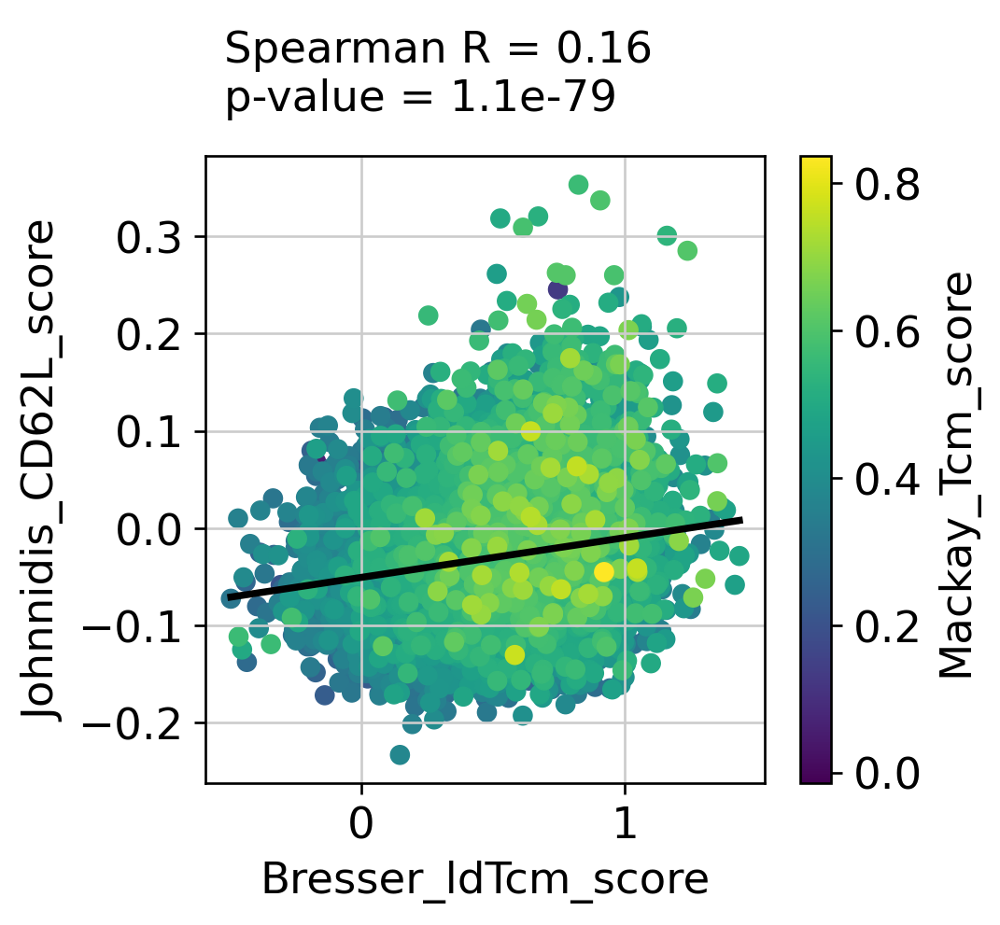

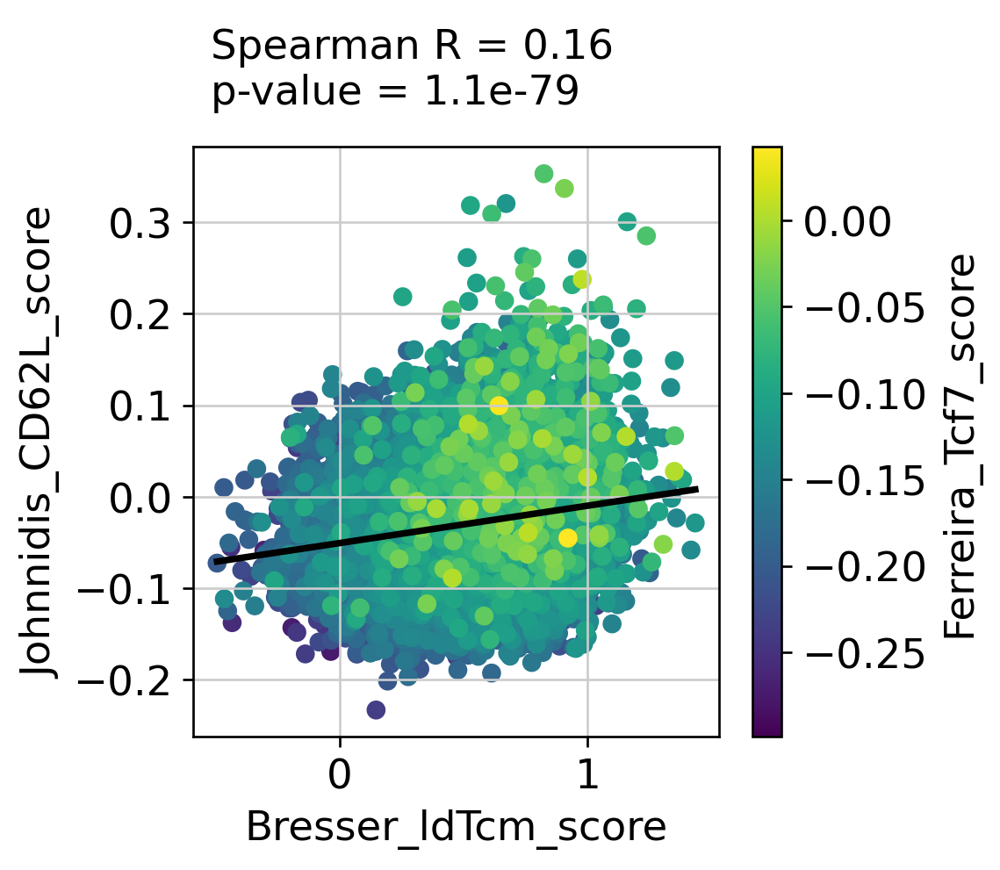

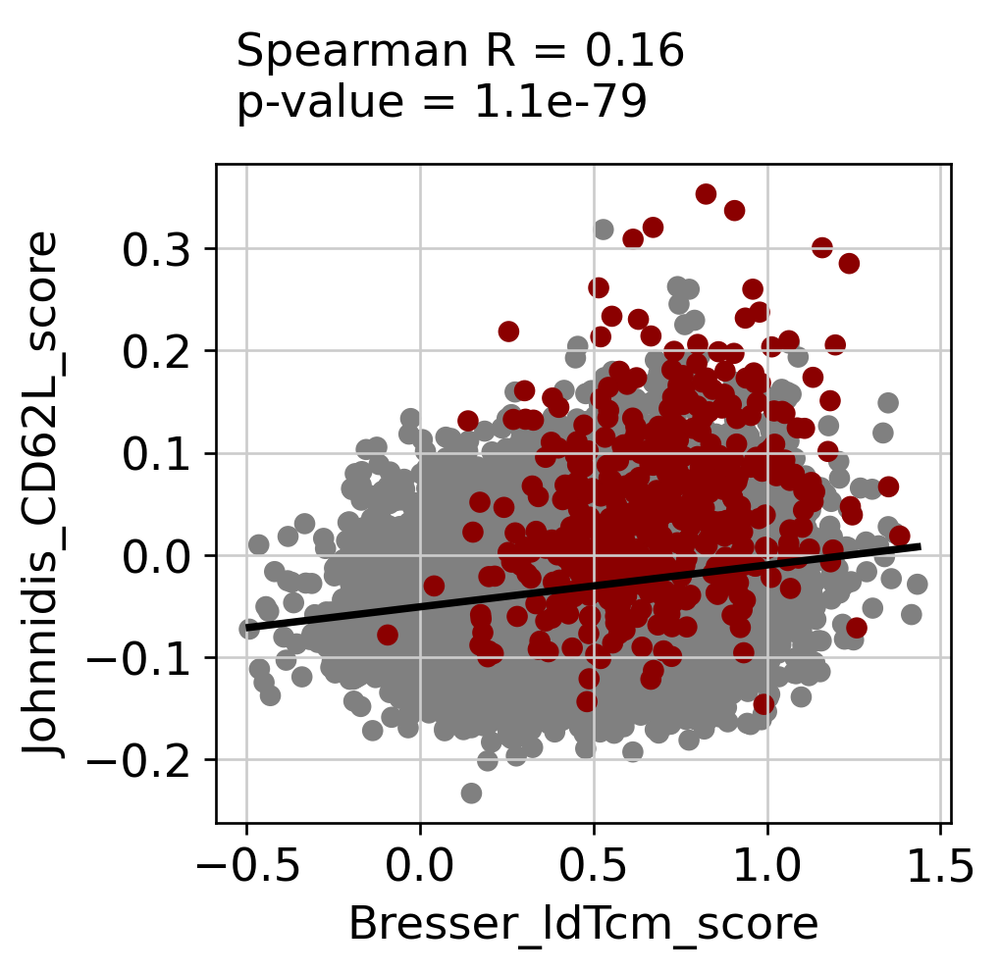

In [10]:
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Albao_Runx3OE_score")
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Tcf7")
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Runx3")
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Tox")
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Mackay_Tcm_score")
scatter_continuous(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "Ferreira_Tcf7_score")
scatter_select(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "leiden_r1", highlight = "6")

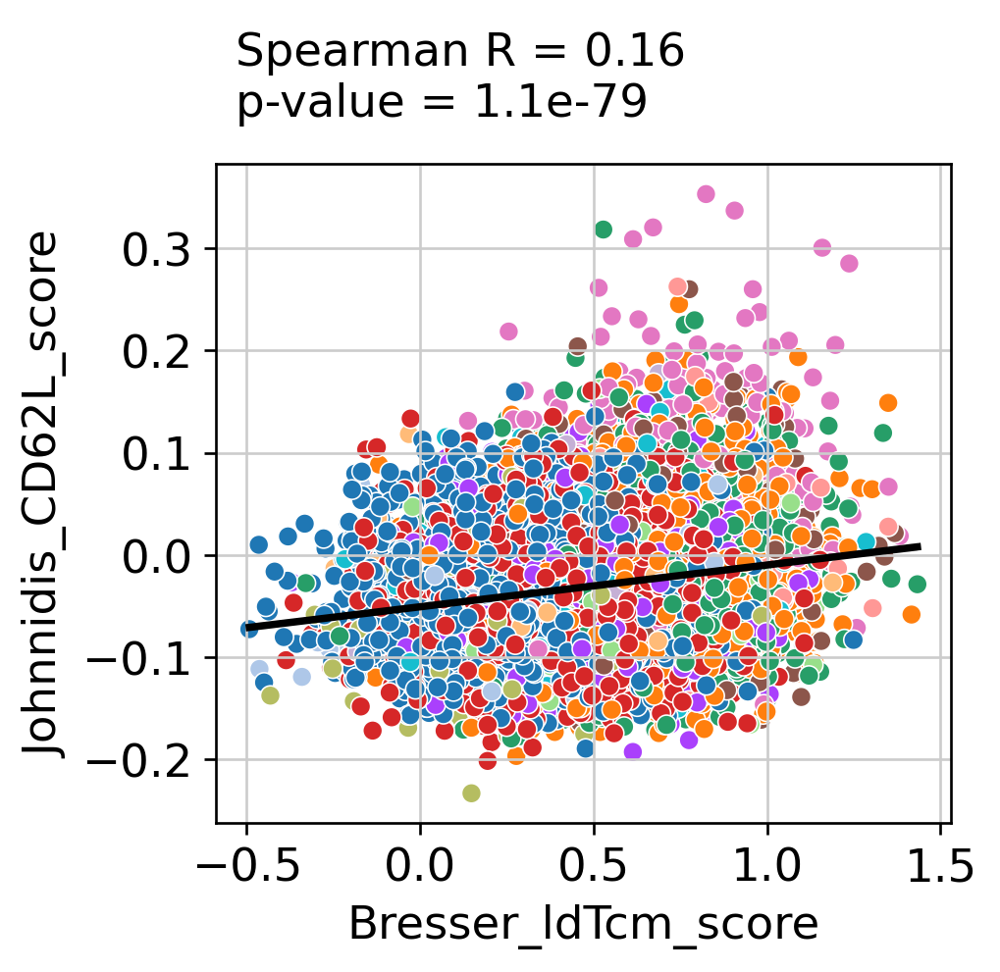

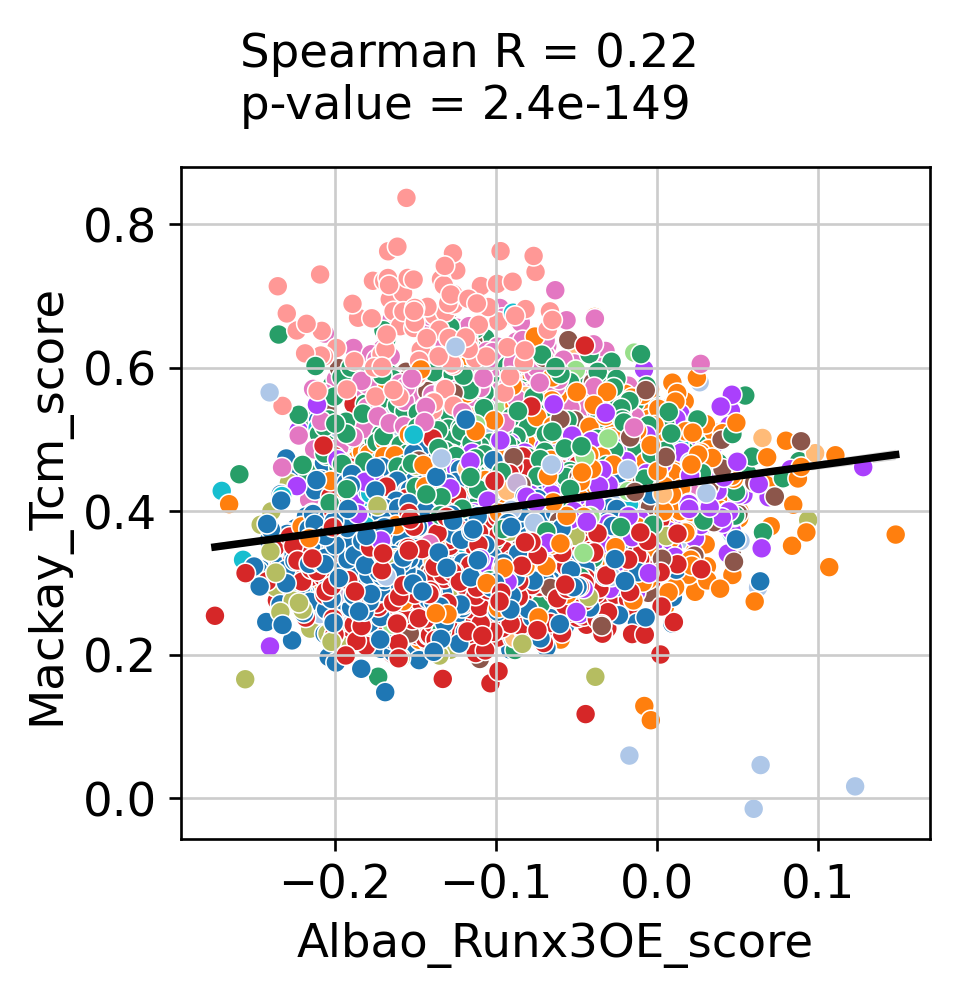

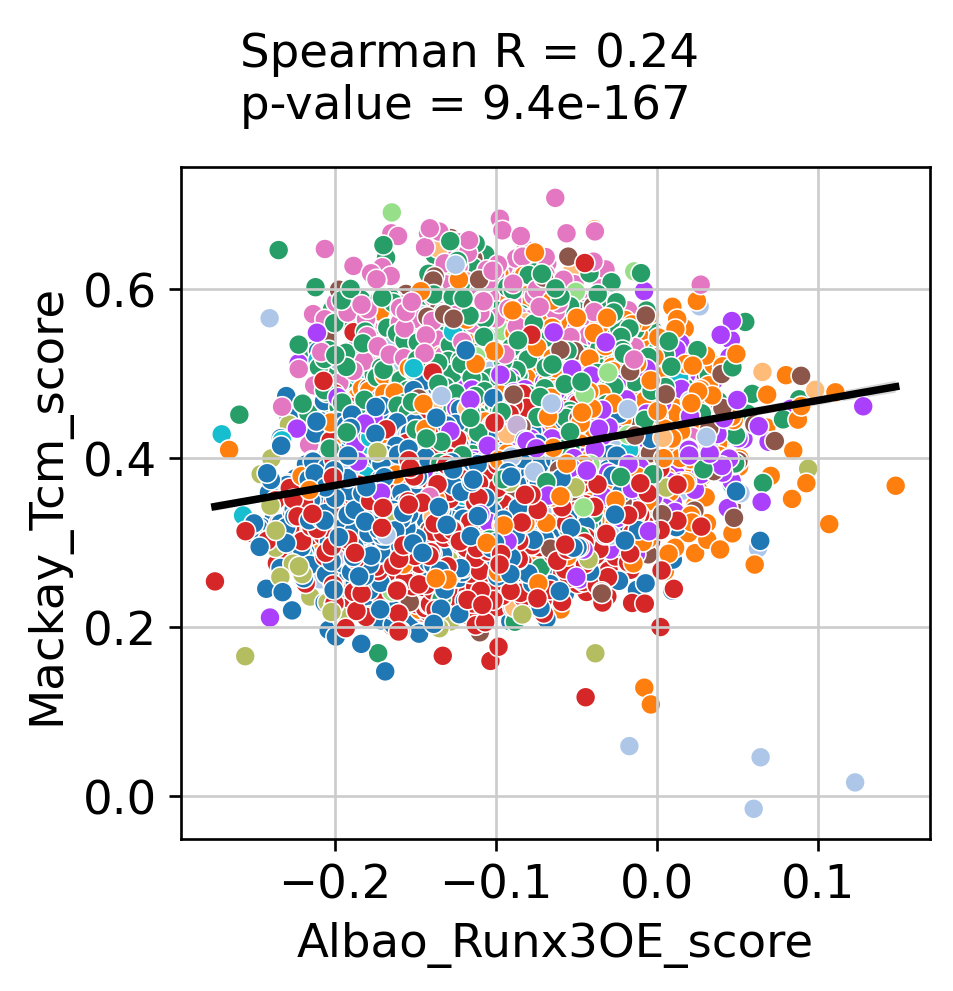

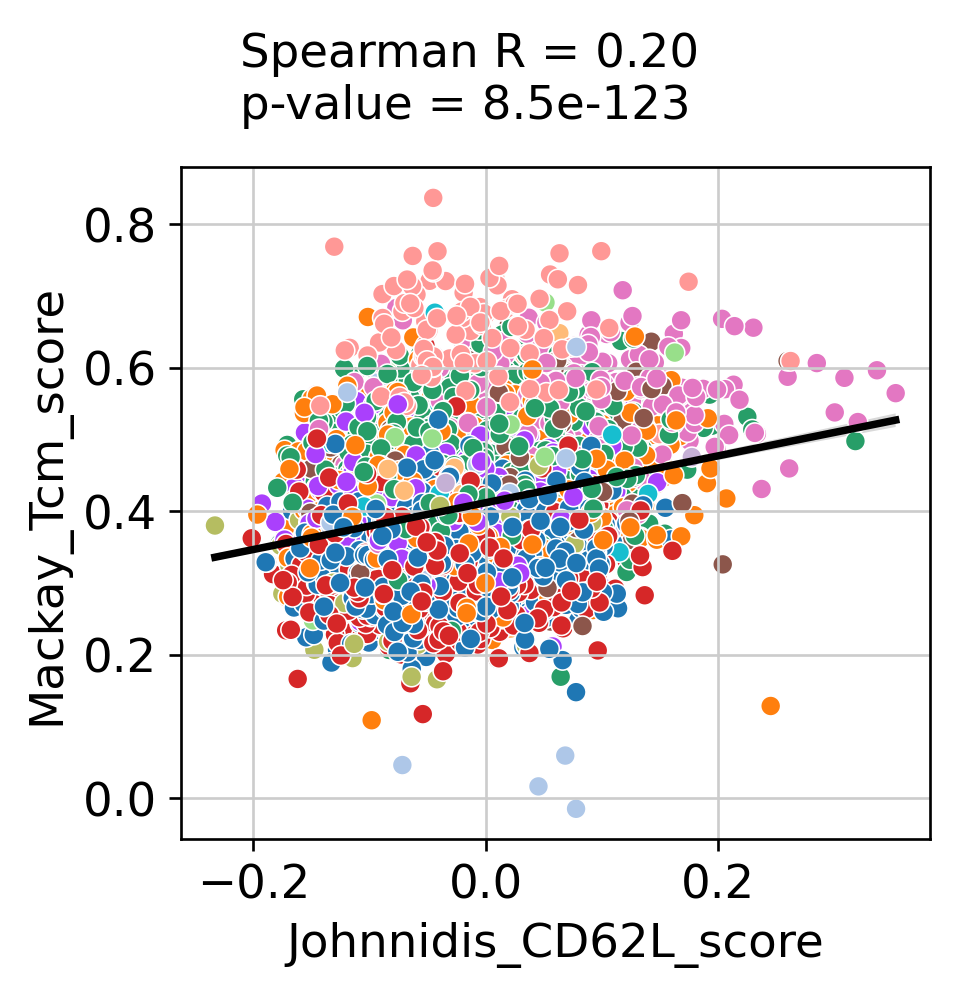

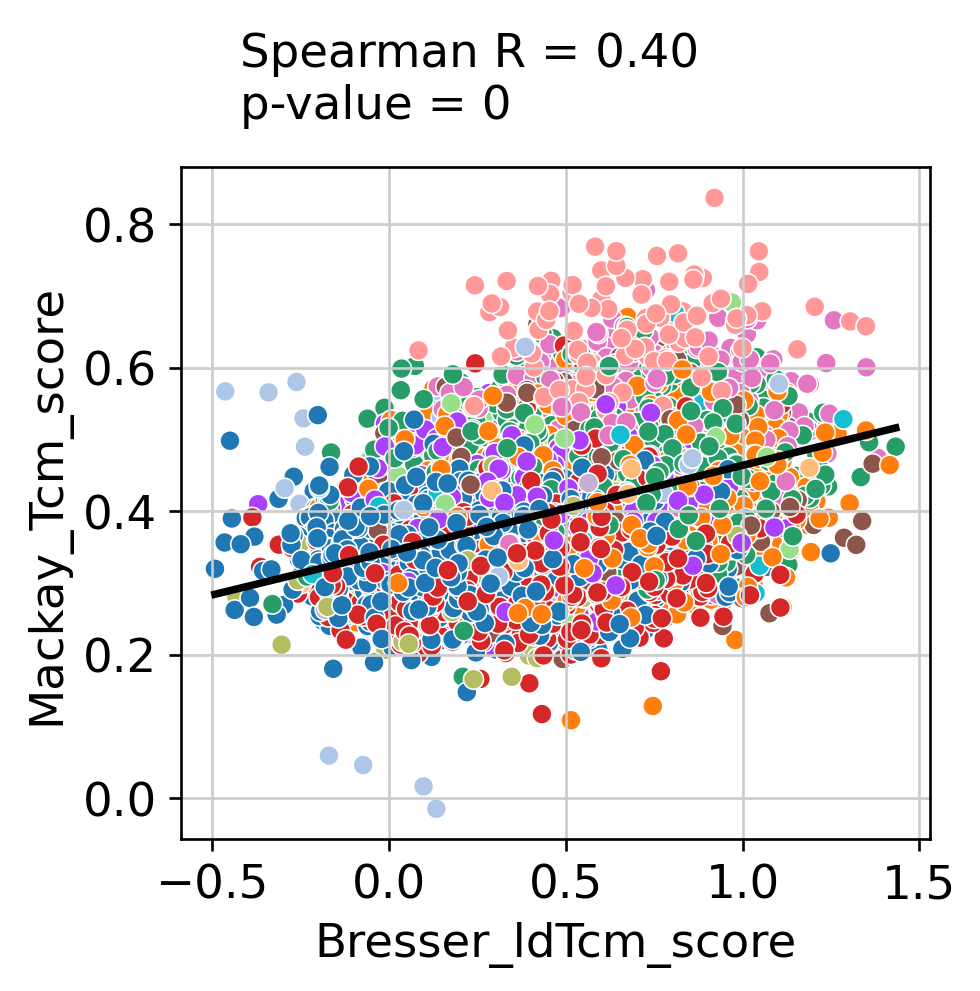

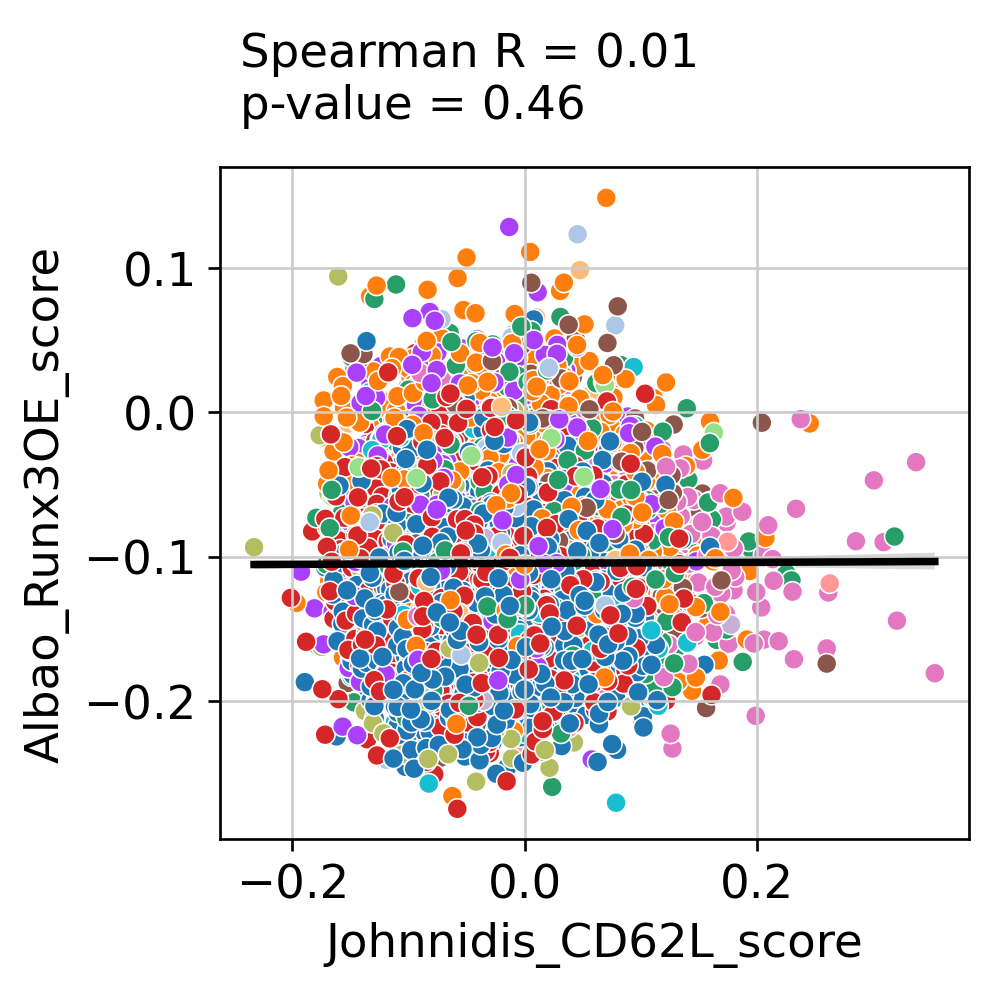

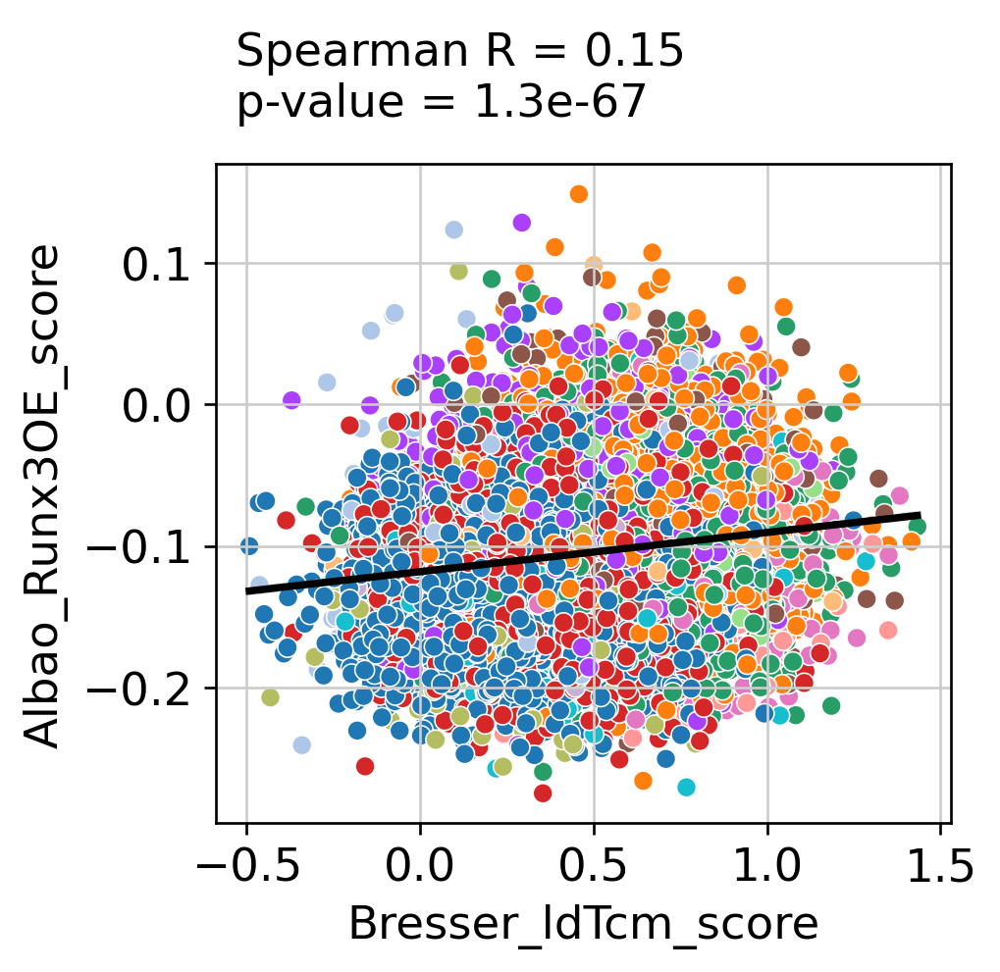

In [11]:
scatter_discrete(df_orig, x = "Bresser_ldTcm_score", y = "Johnnidis_CD62L_score", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Albao_Runx3OE_score", y = "Mackay_Tcm_score", hue = "leiden_r1")
scatter_discrete(df_orig[df_orig["group"] != "Naive"], x = "Albao_Runx3OE_score", y = "Mackay_Tcm_score", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Johnnidis_CD62L_score", y = "Mackay_Tcm_score", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Bresser_ldTcm_score", y = "Mackay_Tcm_score", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Johnnidis_CD62L_score", y = "Albao_Runx3OE_score", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Bresser_ldTcm_score", y = "Albao_Runx3OE_score", hue = "leiden_r1")

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


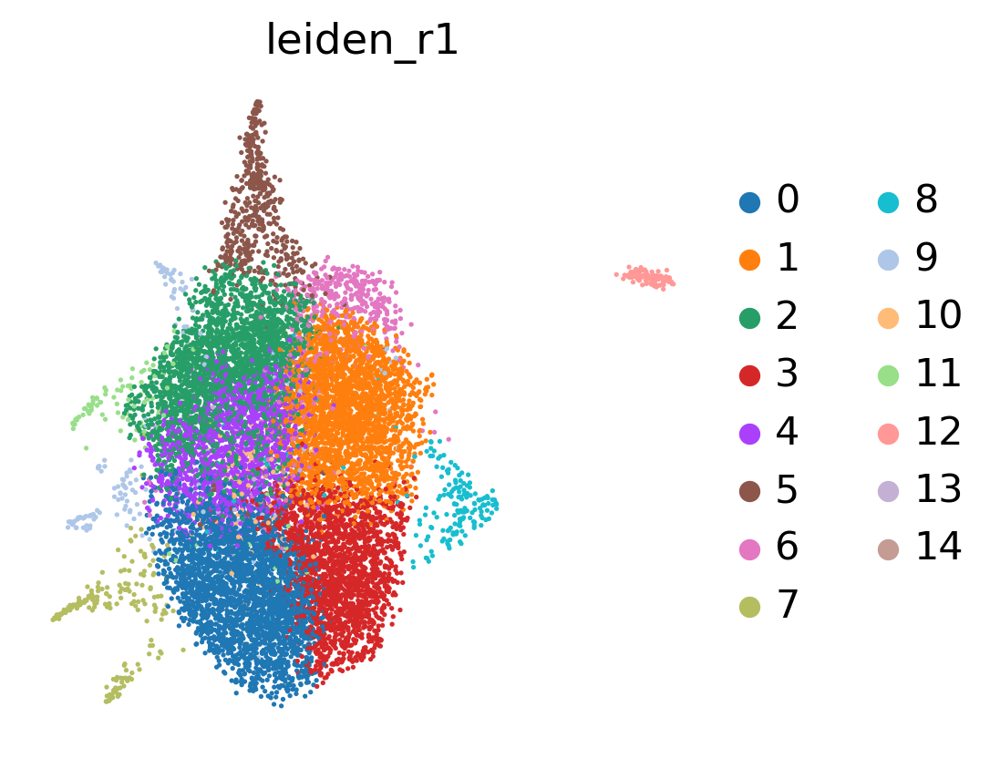

In [12]:
sc.pl.umap(adata, color="leiden_r1", size = 10, frameon = False)

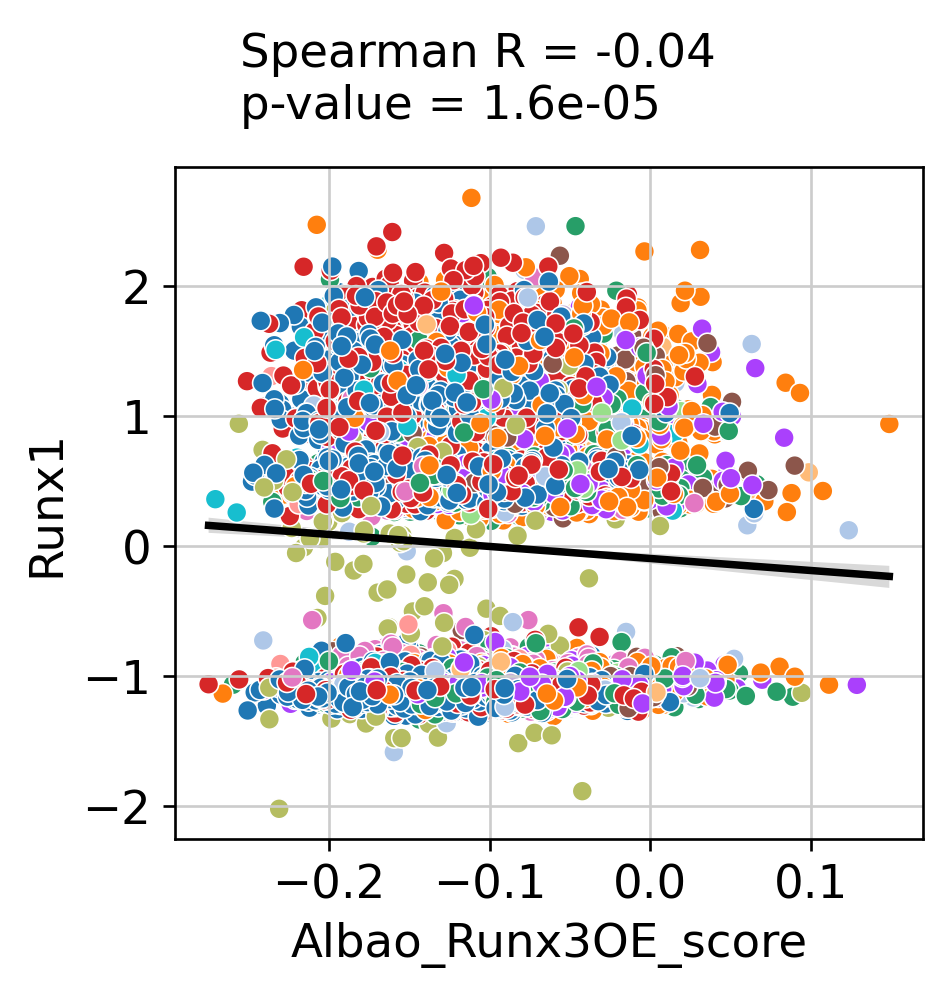

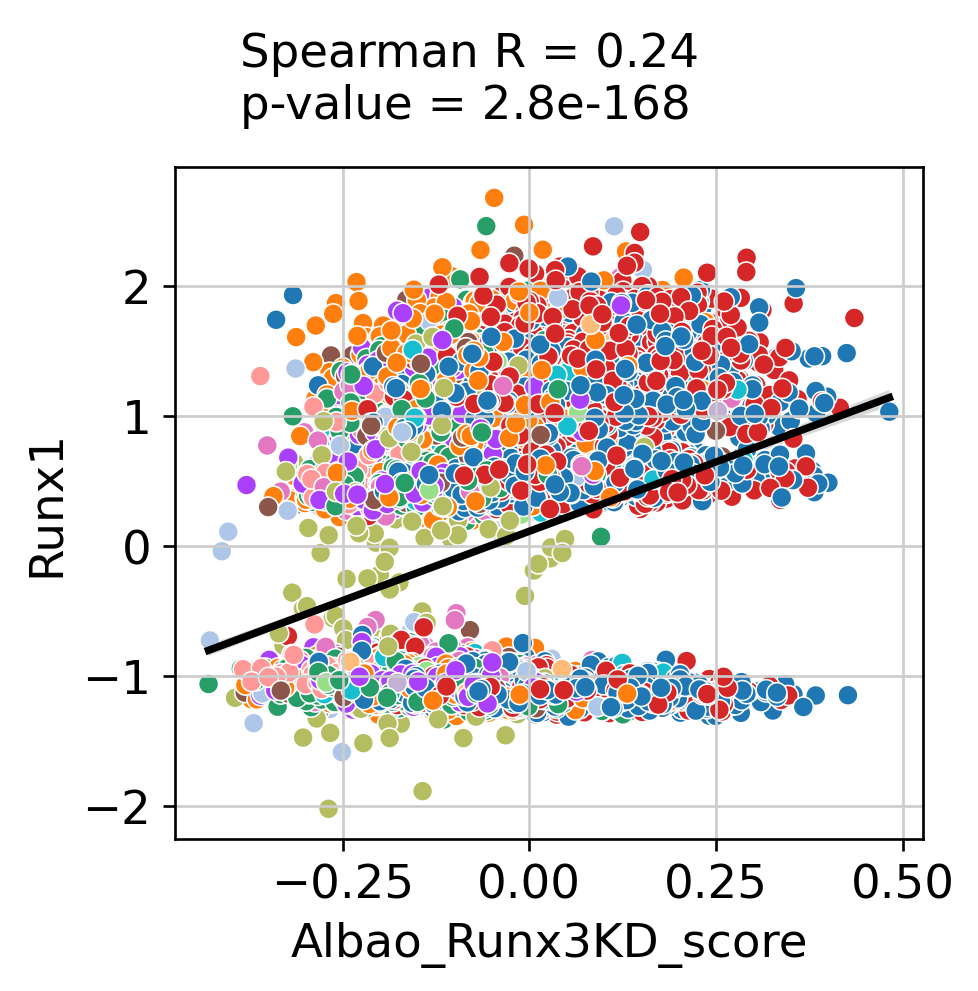

In [13]:
scatter_discrete(df_orig, x = "Albao_Runx3OE_score", y = "Runx1", hue = "leiden_r1")
scatter_discrete(df_orig, x = "Albao_Runx3KD_score", y = "Runx1", hue = "leiden_r1")

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


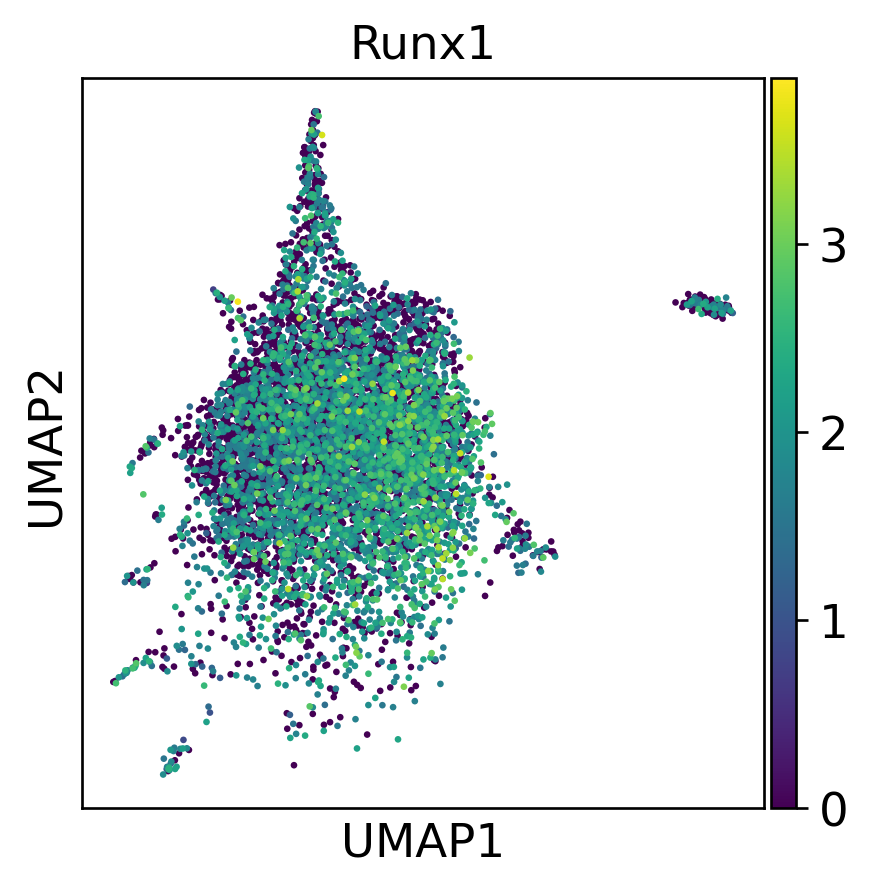

In [14]:
sc.pl.umap(adata[adata.obs.group != "TE", :], color = "Runx1")

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


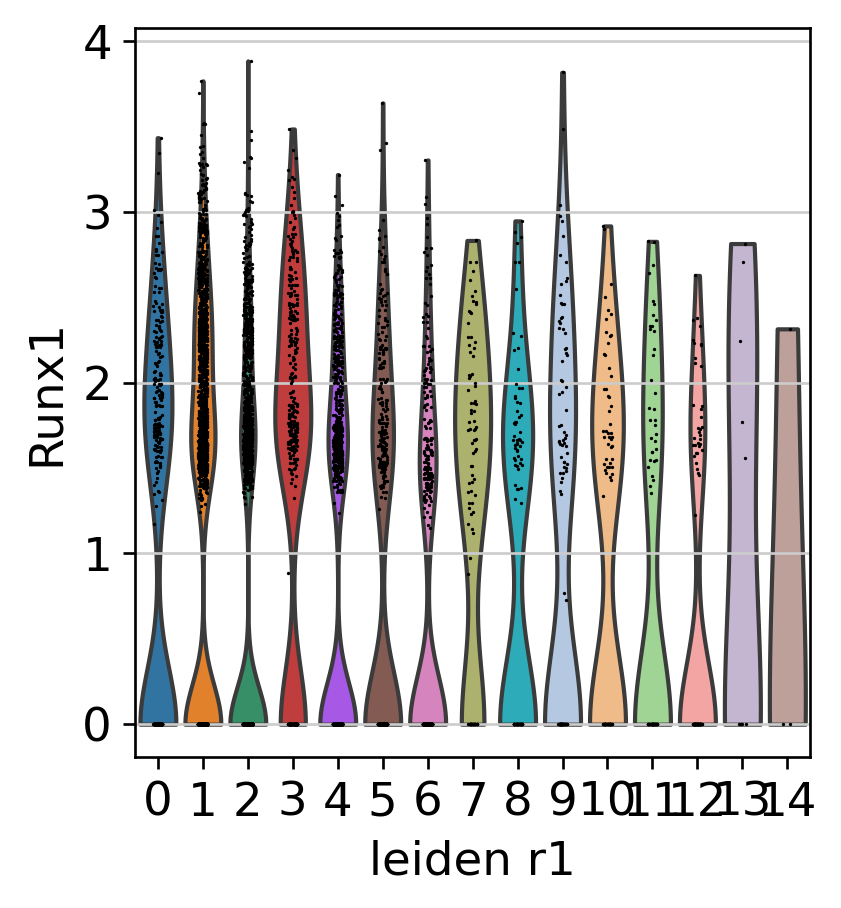

In [15]:
sc.pl.violin(adata[adata.obs.group != "TE", :], "Runx1", groupby = "leiden_r1")

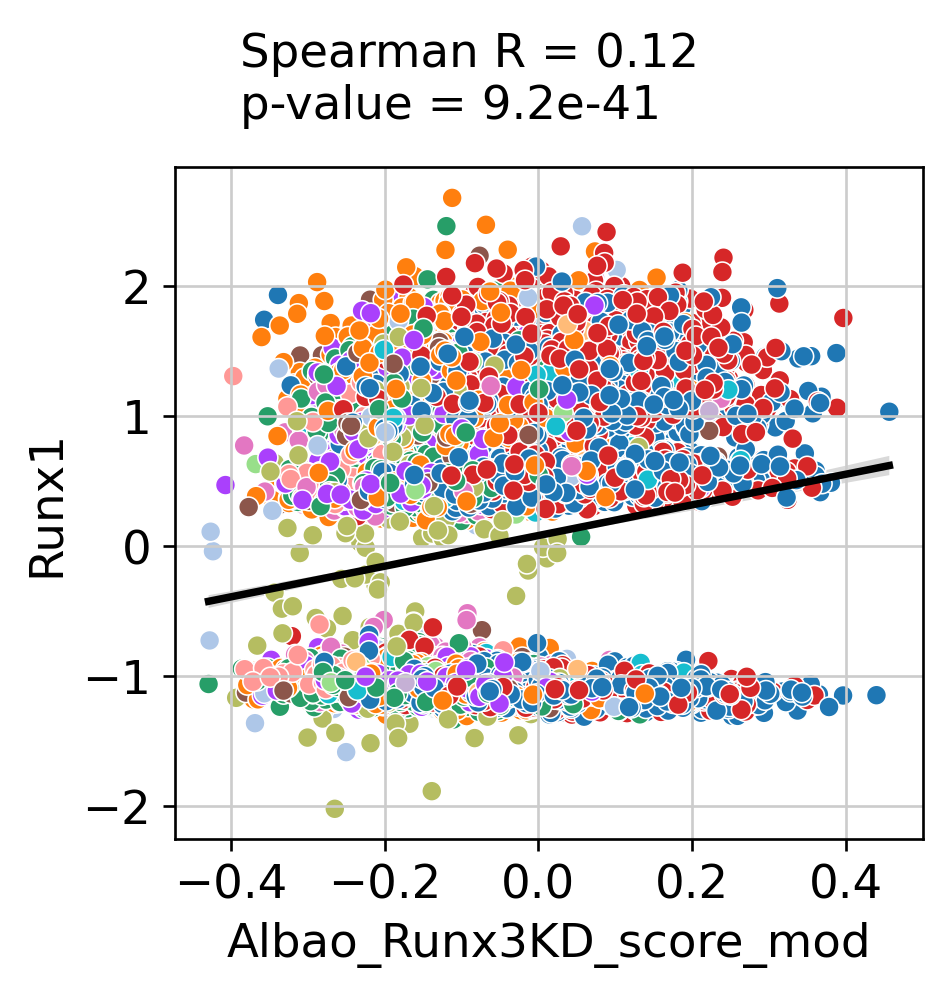

In [16]:
gene_lists["Albao_Runx3KD"].remove("Runx1")
sc.tl.score_genes(adata=adata, gene_list=gene_lists["Albao_Runx3KD"], score_name="Albao_Runx3KD_score_mod")
df_orig = sc.get.obs_df(adata, ["Runx3", "Runx1", "Runx2", "Tcf7", "Tox", "leiden_r1", "group", "Albao_Runx3KD_score_mod"] + [item + "_score" for item in list_names])
scatter_discrete(df_orig, x = "Albao_Runx3KD_score_mod", y = "Runx1", hue = "leiden_r1")

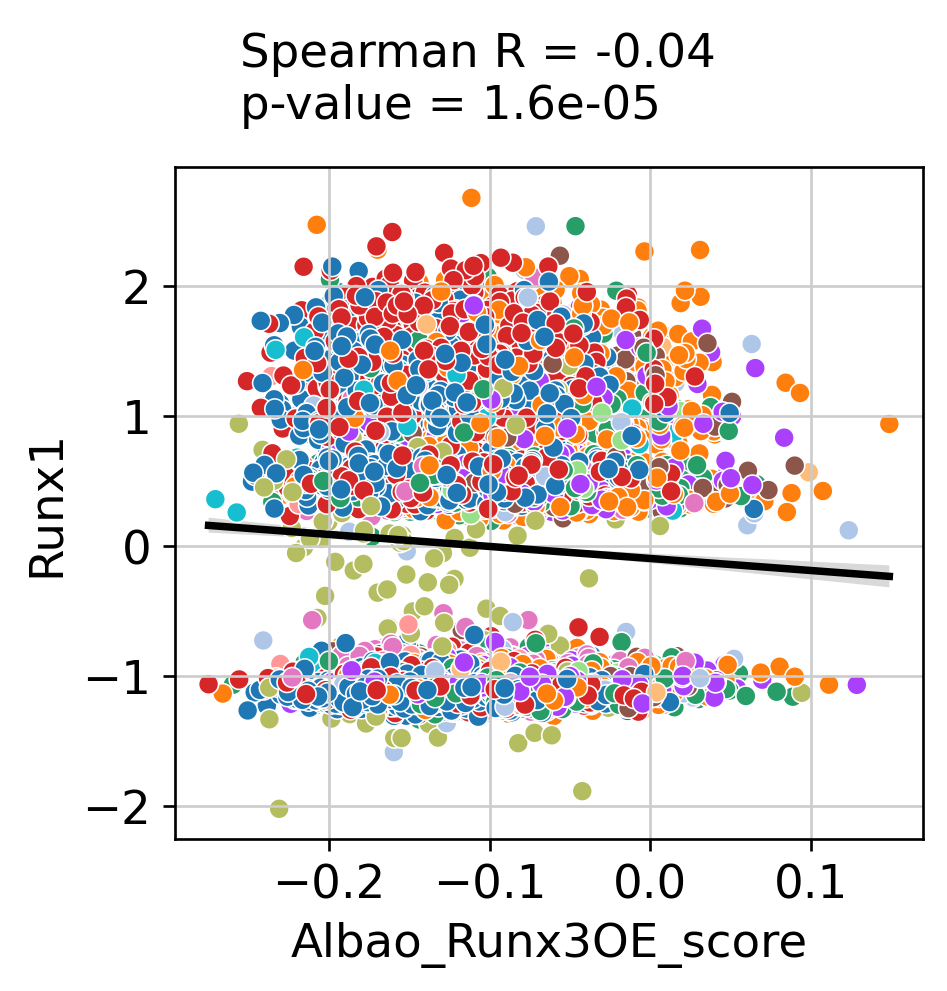

In [17]:
scatter_discrete(df_orig, x = "Albao_Runx3OE_score", y = "Runx1", hue = "leiden_r1")

In [18]:
def scatter_select(df, x, y, hue, highlight, color):
    # Compute the Spearman correlation and p-value
    correlation, p_value = spearmanr(df[x], df[y])
    
    # Create the main figure and axis
    fig, ax = plt.subplots()

    # Adjust the plot layout to make room for the annotation at the top
    fig.subplots_adjust(top=0.85)  # you might need to tweak this value
    
    # Plot the regression trendline for the entire dataset
    sns.regplot(x=x, y=y, data=df, scatter=False, color='black', ax=ax)
    
    # Custom color mapping for leiden_r1 values
    color_mapping = {highlight: color}
    colors = df[hue].map(lambda x: color_mapping.get(x, 'grey'))
    
    # Sort the DataFrame such that entries with "6" in leiden_r1 come last
    df_sorted = df.sort_values(by=hue, key=lambda col: col == highlight, ascending=True)
    
    # Overlay the scatter plot with custom colors
    sns.scatterplot(x=x, y=y, color=colors.loc[df_sorted.index], data=df_sorted, edgecolor=None, ax=ax, legend=False)
    
    # Add the Spearman R and p-value ABOVE the plot
    ax.annotate(f"Spearman R = {correlation:.2f}\np-value = {p_value:.2g}", 
                xy=(0.25, 1), xycoords='figure fraction', ha='left', va='top')
    
    # Display the plot
    plt.show()

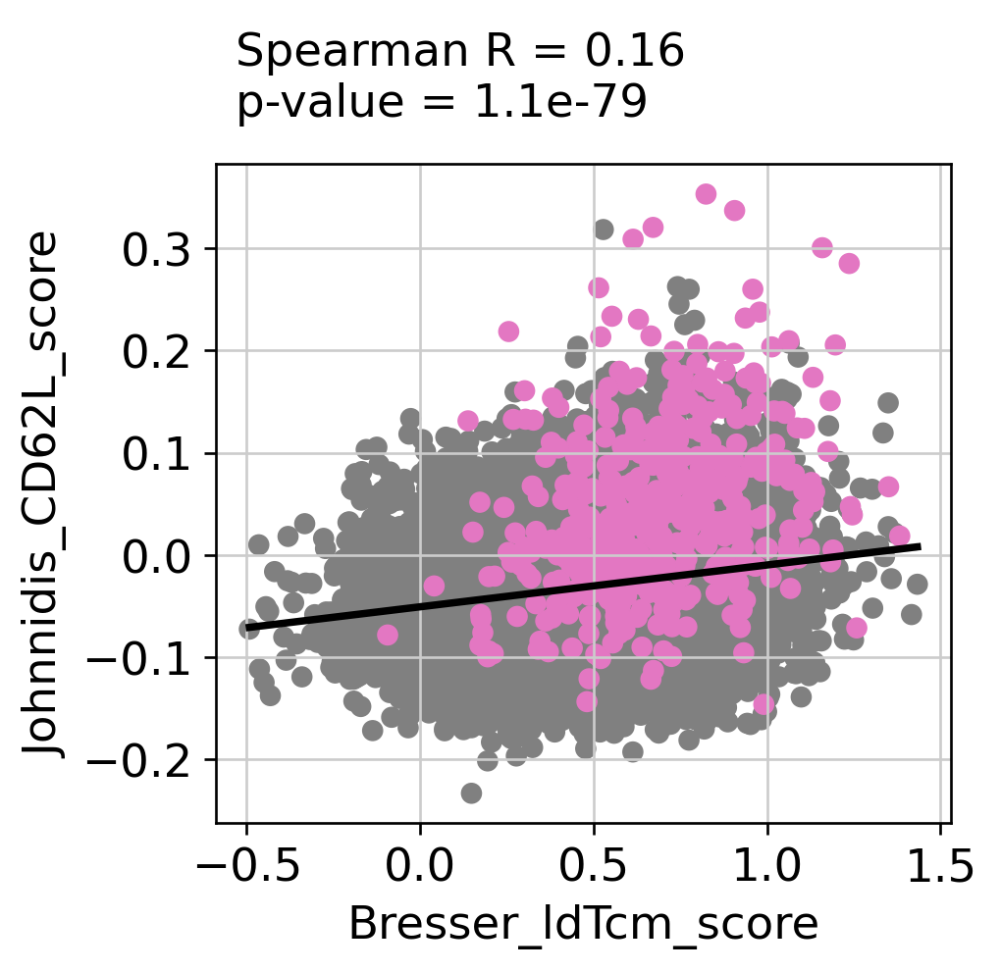

In [19]:
scatter_select(df_orig, "Bresser_ldTcm_score", "Johnnidis_CD62L_score", hue = "leiden_r1", highlight = "6", color = '#e377c2', )